<a href="https://colab.research.google.com/github/s83512266/Tibame_AI_111-2_group2_project/blob/main/Data_generator_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install tensorflow_addons

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
import numpy as np
import cv2
import matplotlib.pyplot as plt # seaborn
from PIL import Image

import os # file path
from glob import glob # search files
from tqdm.auto import tqdm # progress bar

import tensorflow as tf
from tensorflow.keras import layers, models, utils
import tensorflow_addons as tfa

from sklearn.model_selection import train_test_split

# Read one image


In [3]:
IMG_SIZE = 256 # 256 128 64
BATCH_SIZE = 64

all_class = ['MD_Normal', 'MD_old_water', 'MD_sunburnt', 'MD_bac_fungi', 'Others']
class_map = {cls: i for i, cls in enumerate(all_class)} 
#  'MD_Normal':0, 'MD_old_water':1, 'MD_sunburnt':2, 'MD_bac_fungi':3, 'Others':4
class_map

{'MD_Normal': 0,
 'MD_old_water': 1,
 'MD_sunburnt': 2,
 'MD_bac_fungi': 3,
 'Others': 4}

In [4]:
MD_path = glob("/content/drive/MyDrive/圖片/(a.b) 正常龜背芋/train/*.jpg")
MD_old_water_path = glob("/content/drive/MyDrive/圖片/(c.e.f) 老化、水和空氣/train/*.jpg")
MD_sunburnt_path = glob("/content/drive/MyDrive/圖片/(d)曬傷/train/*.jpg")
MD_bac_fungi_path = glob("/content/drive/MyDrive/圖片/(g.h)真菌/train/*.jpg")
Others_path = glob("/content/drive/MyDrive/圖片/(i)非龜背芋種/train/*.jpg")

img_paths = MD_path + MD_old_water_path + MD_sunburnt_path + MD_bac_fungi_path + Others_path

# number of images
print('img_paths:', len(img_paths))
print('MD_path:', len(MD_path))
print('MD_old_water_path:', len(MD_old_water_path))
print('MD_sunburnt_path:', len(MD_sunburnt_path))
print('MD_bac_fungi_path:', len(MD_bac_fungi_path))
print('Others_path:', len(Others_path))

img_paths: 1622
MD_path: 639
MD_old_water_path: 137
MD_sunburnt_path: 69
MD_bac_fungi_path: 92
Others_path: 685


In [5]:
from sklearn.model_selection import train_test_split
# split train and test dataset
MD_path_train, MD_path_test = train_test_split(MD_path, test_size=0.3)
MD_old_water_path_train, MD_old_water_path_test = train_test_split(MD_old_water_path, test_size=0.3)
MD_sunburnt_path_train, MD_sunburnt_path_test = train_test_split(MD_sunburnt_path, test_size=0.3)
MD_bac_fungi_path_train, MD_bac_fungi_path_test = train_test_split(MD_bac_fungi_path, test_size=0.3)
Others_path_train, Others_path_test = train_test_split(Others_path, test_size=0.3)

# split test and val dataset
MD_path_test, MD_path_val = train_test_split(MD_path_test, test_size=0.5)
MD_old_water_path_test, MD_old_water_path_val = train_test_split(MD_old_water_path_test, test_size=0.5)
MD_sunburnt_path_test, MD_sunburnt_path_val = train_test_split(MD_sunburnt_path_test, test_size=0.5)
MD_bac_fungi_path_test, MD_bac_fungi_path_val = train_test_split(MD_bac_fungi_path_test, test_size=0.5)
Others_path_test, Others_path_val = train_test_split(Others_path_test, test_size=0.5)

MD_sick_paths_train = MD_old_water_path_train * 2 + MD_sunburnt_path_train * 4 + MD_bac_fungi_path_train * 3
img_paths_train = MD_path_train + MD_sick_paths_train + MD_sick_paths_train + Others_path_train
img_paths_val = MD_path_val + MD_old_water_path_val + MD_sunburnt_path_val + MD_bac_fungi_path_val + Others_path_val
img_paths_test = MD_path_test + MD_old_water_path_test + MD_sunburnt_path_test + MD_bac_fungi_path_test + Others_path_test

# number of train images
print('img_paths_train:', len(img_paths_train))
print('MD_path_train:', len(MD_path_train))
print('MD_old_water_path_train:', len(MD_old_water_path_train))
print('MD_sunburnt_path_train:', len(MD_sunburnt_path_train))
print('MD_bac_fungi_path_train:', len(MD_bac_fungi_path_train))
print('Others_path_train:', len(Others_path_train))
print('MD_sick_paths_train:', len(MD_sick_paths_train))

print("====================================")
# number of val images
print('img_paths_val:', len(img_paths_val))
print('MD_path_val:', len(MD_path_val))
print('MD_old_water_path_val:', len(MD_old_water_path_val))
print('MD_sunburnt_path_val:', len(MD_sunburnt_path_val))
print('MD_bac_fungi_path_val:', len(MD_bac_fungi_path_val))
print('Others_path_val:', len(Others_path_val))
print("====================================")
# number of test images
print('img_paths_test:', len(img_paths_test))
print('MD_path_test:', len(MD_path_test))
print('MD_old_water_path_test:', len(MD_old_water_path_test))
print('MD_sunburnt_path_test:', len(MD_sunburnt_path_test))
print('MD_bac_fungi_path_test:', len(MD_bac_fungi_path_test))
print('Others_path_test:', len(Others_path_test))


img_paths_train: 2074
MD_path_train: 447
MD_old_water_path_train: 95
MD_sunburnt_path_train: 48
MD_bac_fungi_path_train: 64
Others_path_train: 479
MD_sick_paths_train: 574
img_paths_val: 245
MD_path_val: 96
MD_old_water_path_val: 21
MD_sunburnt_path_val: 11
MD_bac_fungi_path_val: 14
Others_path_val: 103
img_paths_test: 244
MD_path_test: 96
MD_old_water_path_test: 21
MD_sunburnt_path_test: 10
MD_bac_fungi_path_test: 14
Others_path_test: 103


/content/drive/MyDrive/圖片/(a.b) 正常龜背芋/train/1.jpg
(3000, 3000, 3)


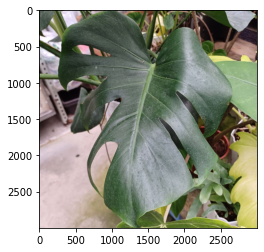

In [6]:
# show image
path = img_paths[0]
path1 = MD_path[1]
img = cv2.imread(path1)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
print(path)
print(img.shape)
plt.imshow(img)
plt.show()

((3000, 3000, 3), (256, 256, 3))

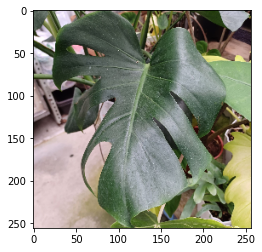

In [7]:
# Resize  img
img_resized = cv2.resize(img, (IMG_SIZE, IMG_SIZE))
plt.imshow(img_resized)
img.shape, img_resized.shape

In [8]:
# Extract img class
# os.sep: /
print(path)
cls = path.split(os.sep)[-3]
print(cls)

/content/drive/MyDrive/圖片/(a.b) 正常龜背芋/train/1.jpg
(a.b) 正常龜背芋


In [9]:
# Get file class index for train

# for MD_Normal class
if cls == '(a.b) 正常龜背芋':
    cls_idx = class_map["MD_Normal"]
    print(cls_idx)
# for sick class
elif cls == '(c.e.f) 老化、水和空氣':
    cls_idx = class_map["MD_old_water"]
    print(cls_idx)
elif cls == '(d)曬傷':
    cls_idx = class_map["MD_sunburnt"]
    print(cls_idx)
elif cls == '(g.h)真菌':
    cls_idx = class_map["MD_bac_fungi"]
    print(cls_idx)
# for others class
else:
    cls_idx = class_map["Others"]
    print(cls_idx)

0


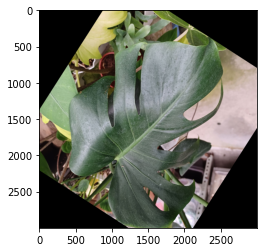

In [10]:
import imgaug as ia
import imgaug.augmenters as iaa

aug = iaa.Sequential([iaa.Fliplr(0.5), # 50% horizontal flip
        iaa.Flipud(0.5), # 50% vertical flip
        iaa.Affine(
              rotate=(-30, 30), # random rotate -30 ~ +30 degree
              shear=(-16, 16), # random shear -16 ~ +16 degree
              scale={"x": (0.8, 1.2), "y": (0.8, 1.2)} # scale x, y: 80%~120%
              )
        ])

img = aug.augment_image(img)
plt.imshow(img)

# Data Generator

https://www.tensorflow.org/api_docs/python/tf/keras/utils/Sequence

*   def \_\_len\_\_: number of **batches** per epoch
*   def \_\_getitem\_\_(idx): get the idx-th batch
* def \_\_on_epoch_end\_\_: called at the end of epoch


In [11]:
import imgaug as ia
import imgaug.augmenters as iaa

class DataGenerator(utils.Sequence):
    def __init__(self, paths, batch_size, img_size, mode='train'):
        self.paths = paths
        self.batch_size = batch_size
        self.mode = mode
        self.img_size = img_size

        self.shuffle = mode == 'train'
        self.idxs = np.arange(len(self.paths)) # [0, 1, 2, ..., len(self.paths)-1]
        self.all_class = ['MD_Normal', 'MD_old_water', 'MD_sunburnt', 'MD_bac_fungi', 'Others']
        self.class_map = {cls: i for i, cls in enumerate(all_class)}
        self.num_classes = len(self.class_map)
        self.on_epoch_end()
        # augmentation
        self.aug = iaa.Sequential([
            iaa.Fliplr(0.5), # 50% horizontal flip
            iaa.Flipud(0.5), # 50% vertical flip
            iaa.Affine(
                rotate=(-30, 30), # random rotate -30 ~ +30 degree
                shear=(-16, 16), # random shear -16 ~ +16 degree
                scale={"x": (0.8, 1.2), "y": (0.8, 1.2)} # scale x, y: 80%~120%
                )
        ])

    def __len__(self):
        'number of batches per epoch'
        return int(np.ceil(len(self.paths) / self.batch_size))

    def __getitem__(self, batch_index):
        'Generate one batch of data'
        # Generate idxs of the batch
        idxs = self.idxs[batch_index*self.batch_size: (batch_index+1)*self.batch_size]
        # Find list of IDs
        batch_paths = [self.paths[i] for i in idxs]
        # Generate data
        return self.__data_generation(batch_paths)

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        if self.shuffle:
            np.random.shuffle(self.idxs)

    def __data_generation(self, paths):
        """
        Generates data containing batch_size samples
        """
        x = np.empty((len(paths), self.img_size, self.img_size, 3), dtype=np.float32)
        y = np.empty((len(paths)))

        for i, path in enumerate(tqdm(paths)):
            # read image
            img = cv2.imread(path) # (H, W, 3)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img = cv2.resize(img, (IMG_SIZE, IMG_SIZE)) # resize
            

            # # TODO: Data Augmentation
            if self.mode == 'train':
                img = self.aug.augment_image(img)

            # Preprocess
            # img = img / 255.
            img = tf.keras.applications.efficientnet_v2.preprocess_input(img, data_format=None)
            x[i] = img            

            # read class label
            cls = path.split(os.sep)[-3]
            if cls == '(a.b) 正常龜背芋':
                cls_idx = class_map["MD_Normal"]
            # for new_leaf class
            elif cls == '(c.e.f) 老化、水和空氣':
                cls_idx = class_map["MD_old_water"]
            elif cls == '(d)曬傷':
                cls_idx = class_map["MD_sunburnt"]
            elif cls == '(g.h)真菌':
                cls_idx = class_map["MD_bac_fungi"]
            # for others class
            else:
                cls_idx = class_map["Others"]
            y[i] = cls_idx
            
        # one-hot encoding
        y = tf.keras.utils.to_categorical(y, num_classes=self.num_classes)
        return x, y
        

In [12]:
gen_train = DataGenerator(img_paths_train, BATCH_SIZE, IMG_SIZE, mode='train')
gen_val = DataGenerator(img_paths_val, BATCH_SIZE, IMG_SIZE, mode='val')
gen_test = DataGenerator(img_paths_test, BATCH_SIZE, IMG_SIZE, mode='test')

In [13]:
gen_train.idxs

array([1500, 1515,  657, ...,  390,  474, 1811])

In [14]:
# def __len__(): batches per opech
len(gen_train), len(gen_val)

(33, 4)

In [15]:
# get 1 batch
# def __getitem__(self, batch_idx)
imgs, labels = gen_train[0]

  0%|          | 0/64 [00:00<?, ?it/s]

In [16]:
imgs.shape, labels.shape

((64, 256, 256, 3), (64, 5))

label:  [0. 0. 0. 1. 0.]
class idx: 3
class name:  MD_bac_fungi


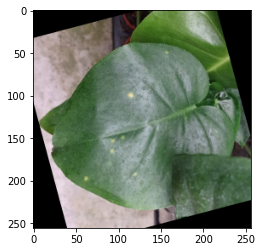

label:  [0. 0. 0. 1. 0.]
class idx: 3
class name:  MD_bac_fungi


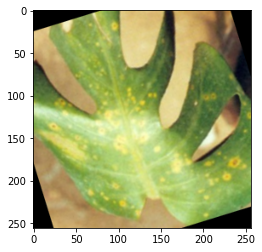

label:  [0. 0. 1. 0. 0.]
class idx: 2
class name:  MD_sunburnt


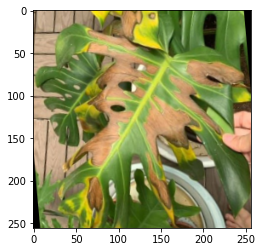

label:  [0. 0. 1. 0. 0.]
class idx: 2
class name:  MD_sunburnt


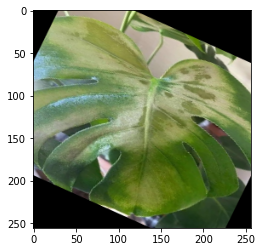

label:  [1. 0. 0. 0. 0.]
class idx: 0
class name:  MD_Normal


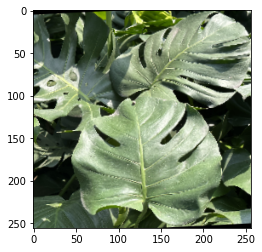

label:  [1. 0. 0. 0. 0.]
class idx: 0
class name:  MD_Normal


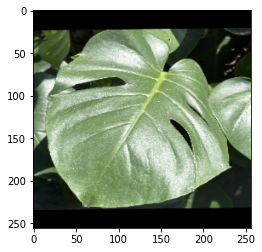

label:  [0. 1. 0. 0. 0.]
class idx: 1
class name:  MD_old_water


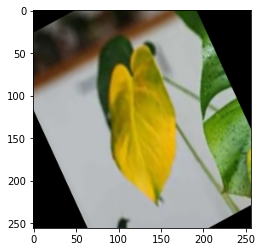

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


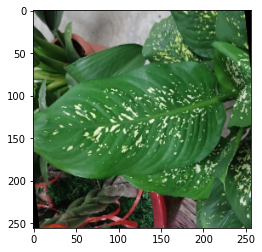

label:  [0. 1. 0. 0. 0.]
class idx: 1
class name:  MD_old_water


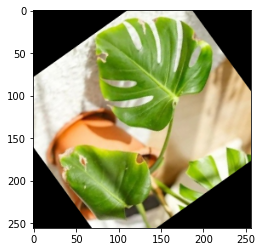

label:  [0. 0. 0. 1. 0.]
class idx: 3
class name:  MD_bac_fungi


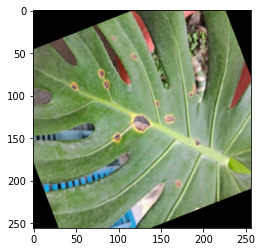

label:  [1. 0. 0. 0. 0.]
class idx: 0
class name:  MD_Normal


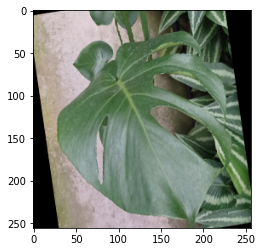

label:  [0. 1. 0. 0. 0.]
class idx: 1
class name:  MD_old_water


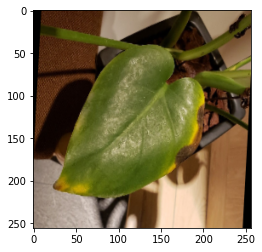

label:  [1. 0. 0. 0. 0.]
class idx: 0
class name:  MD_Normal


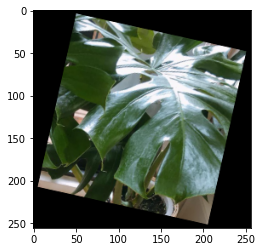

label:  [0. 0. 0. 1. 0.]
class idx: 3
class name:  MD_bac_fungi


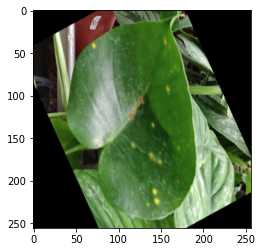

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


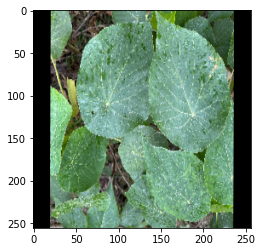

label:  [0. 1. 0. 0. 0.]
class idx: 1
class name:  MD_old_water


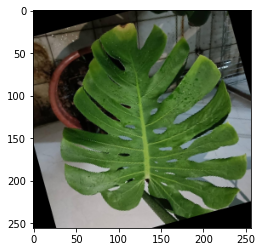

label:  [1. 0. 0. 0. 0.]
class idx: 0
class name:  MD_Normal


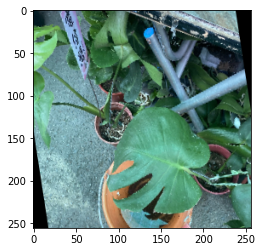

label:  [0. 0. 1. 0. 0.]
class idx: 2
class name:  MD_sunburnt


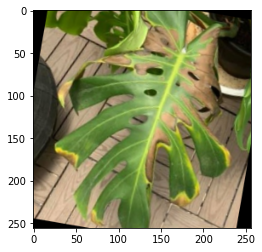

label:  [0. 1. 0. 0. 0.]
class idx: 1
class name:  MD_old_water


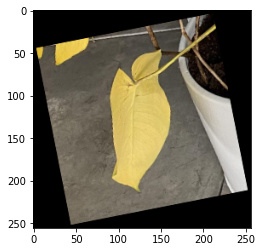

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


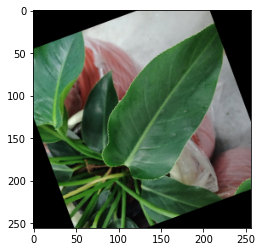

label:  [0. 0. 1. 0. 0.]
class idx: 2
class name:  MD_sunburnt


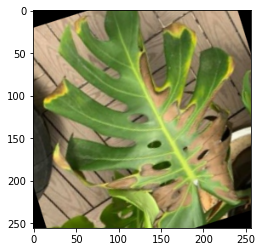

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


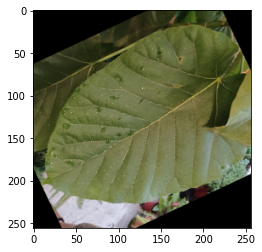

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


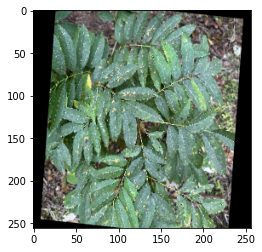

label:  [0. 1. 0. 0. 0.]
class idx: 1
class name:  MD_old_water


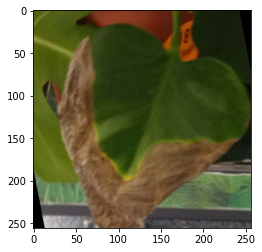

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


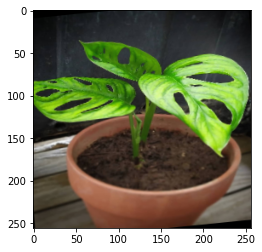

label:  [0. 1. 0. 0. 0.]
class idx: 1
class name:  MD_old_water


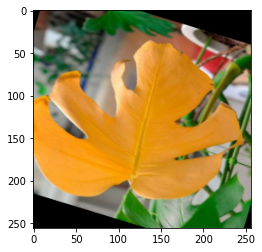

label:  [0. 1. 0. 0. 0.]
class idx: 1
class name:  MD_old_water


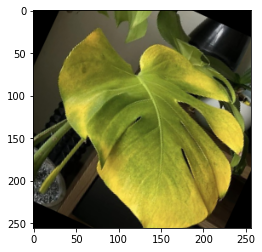

label:  [0. 1. 0. 0. 0.]
class idx: 1
class name:  MD_old_water


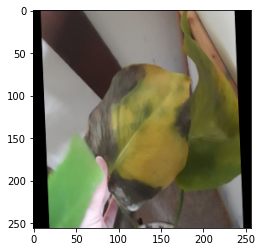

label:  [1. 0. 0. 0. 0.]
class idx: 0
class name:  MD_Normal


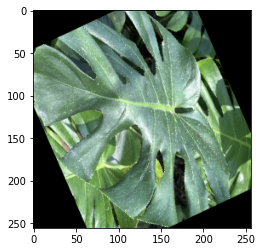

label:  [0. 0. 0. 1. 0.]
class idx: 3
class name:  MD_bac_fungi


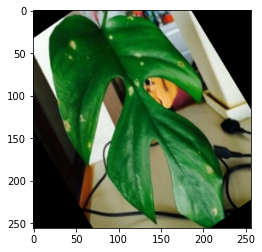

label:  [1. 0. 0. 0. 0.]
class idx: 0
class name:  MD_Normal


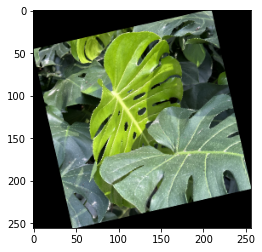

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


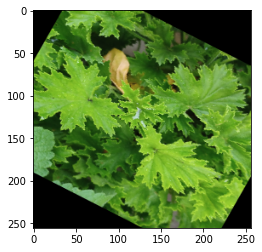

label:  [0. 0. 1. 0. 0.]
class idx: 2
class name:  MD_sunburnt


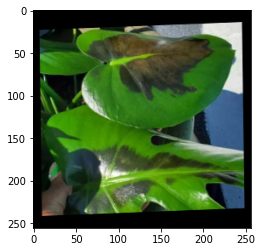

label:  [0. 0. 0. 1. 0.]
class idx: 3
class name:  MD_bac_fungi


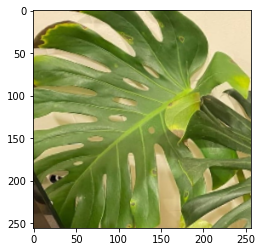

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


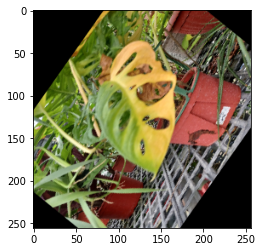

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


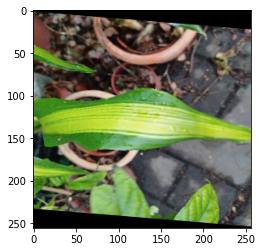

label:  [0. 0. 1. 0. 0.]
class idx: 2
class name:  MD_sunburnt


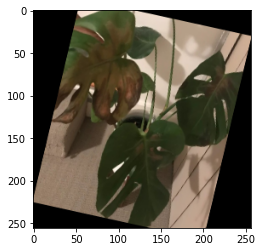

label:  [1. 0. 0. 0. 0.]
class idx: 0
class name:  MD_Normal


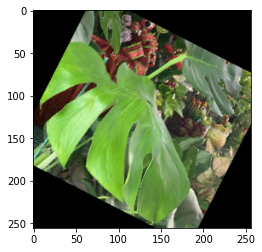

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


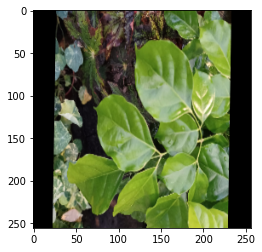

label:  [0. 0. 1. 0. 0.]
class idx: 2
class name:  MD_sunburnt


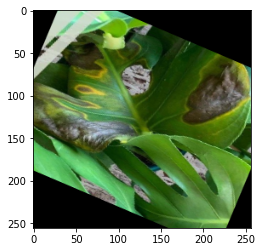

label:  [0. 0. 0. 1. 0.]
class idx: 3
class name:  MD_bac_fungi


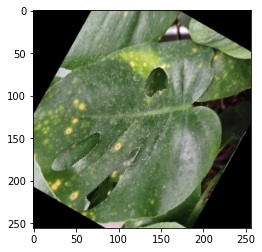

label:  [0. 0. 1. 0. 0.]
class idx: 2
class name:  MD_sunburnt


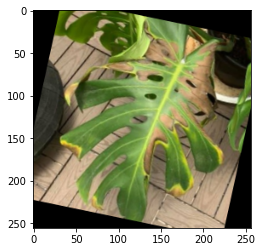

label:  [0. 1. 0. 0. 0.]
class idx: 1
class name:  MD_old_water


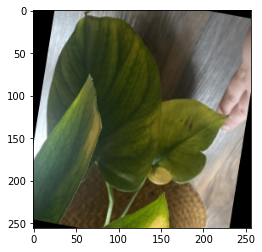

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


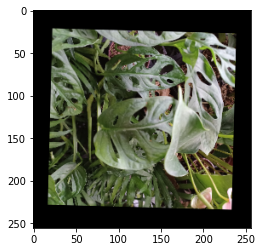

label:  [1. 0. 0. 0. 0.]
class idx: 0
class name:  MD_Normal


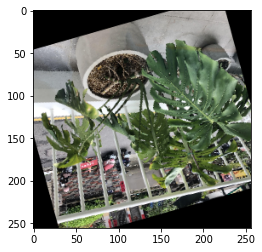

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


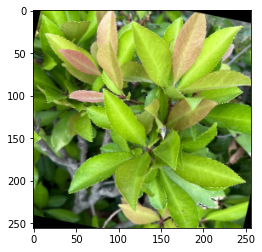

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


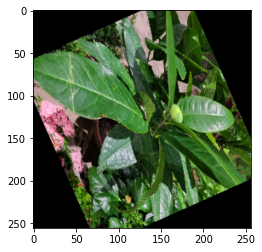

label:  [0. 0. 1. 0. 0.]
class idx: 2
class name:  MD_sunburnt


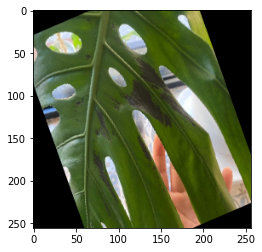

label:  [0. 1. 0. 0. 0.]
class idx: 1
class name:  MD_old_water


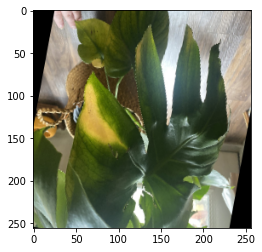

label:  [1. 0. 0. 0. 0.]
class idx: 0
class name:  MD_Normal


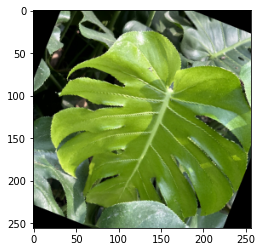

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


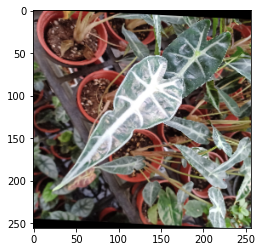

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


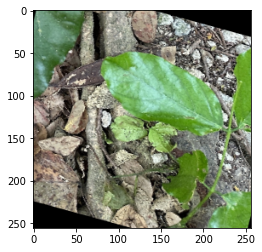

label:  [0. 0. 1. 0. 0.]
class idx: 2
class name:  MD_sunburnt


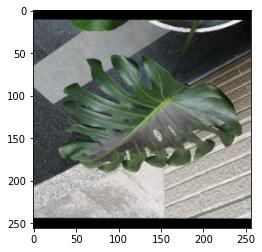

label:  [0. 1. 0. 0. 0.]
class idx: 1
class name:  MD_old_water


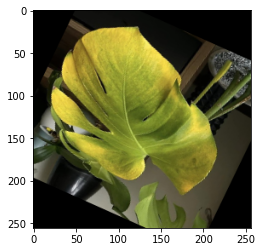

label:  [1. 0. 0. 0. 0.]
class idx: 0
class name:  MD_Normal


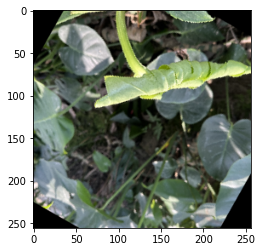

label:  [0. 0. 0. 1. 0.]
class idx: 3
class name:  MD_bac_fungi


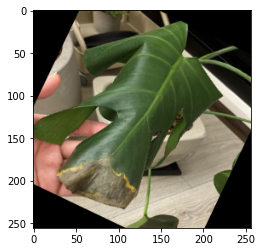

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


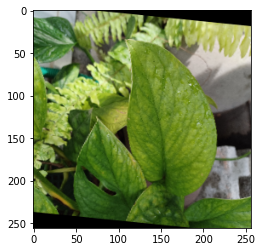

label:  [0. 0. 0. 1. 0.]
class idx: 3
class name:  MD_bac_fungi


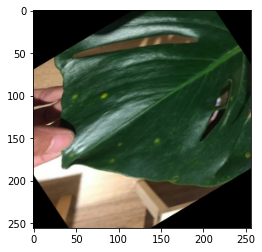

label:  [1. 0. 0. 0. 0.]
class idx: 0
class name:  MD_Normal


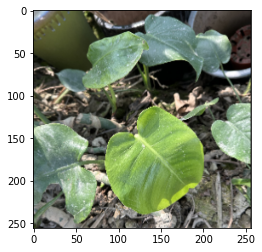

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


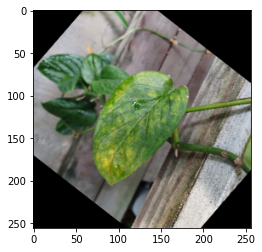

label:  [0. 0. 1. 0. 0.]
class idx: 2
class name:  MD_sunburnt


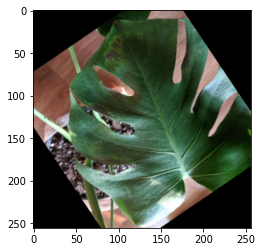

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


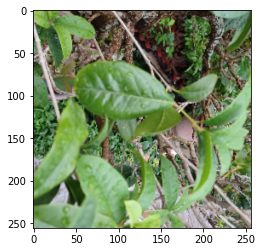

label:  [1. 0. 0. 0. 0.]
class idx: 0
class name:  MD_Normal


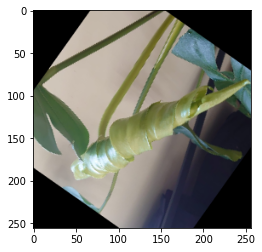

label:  [0. 0. 0. 0. 1.]
class idx: 4
class name:  Others


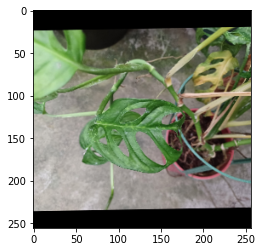

In [17]:
for i in range(len(imgs)):
    label = labels[i]
    class_idx = np.argmax(label)
    print('label: ', label)
    print('class idx:', class_idx)
    print('class name: ', all_class[class_idx])
    img_show = np.array(imgs[i], dtype = np.uint8)
    plt.imshow(img_show)
    plt.show()

# Build model

In [18]:
base_model = tf.keras.applications.EfficientNetV2M(include_top=False, 
                          weights='imagenet',
                          input_shape=(IMG_SIZE, IMG_SIZE, 3))

x = layers.GlobalAveragePooling2D()(base_model.output) 
x = layers.Dense(128, activation='relu')(x)
x = layers.Dense(128, activation='relu')(x)
x = layers.Dropout(0.2)(x)
x = layers.Dense(5, activation='softmax')(x)

# Freeze layers
for l in base_model.layers:
    l.trainable = False

model = models.Model(base_model.input, x)

In [19]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling (Rescaling)          (None, 256, 256, 3)  0           ['input_1[0][0]']                
                                                                                                  
 stem_conv (Conv2D)             (None, 128, 128, 24  648         ['rescaling[0][0]']              
                                )                                                                 
                                                                                              

In [20]:
# y_train是one-hot encoding，不能使用SparseCategoricalCrossentropy()

model.compile(loss=tfa.losses.SigmoidFocalCrossEntropy(),
      # loss=tf.keras.losses.CategoricalCrossentropy(),
            optimizer=tf.keras.optimizers.Adam(),
            metrics=['accuracy'])

In [21]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
callbacks = [
    ModelCheckpoint("/content/drive/MyDrive/generator_v2.h5", save_best_only=True),
    # subclassed models不能使用ModelCheckpoint存模型
    EarlyStopping(patience=10, restore_best_weights=True),
    ReduceLROnPlateau(patience=3, factor=0.3)
    # 當模型連續訓練n次沒有更好，就進行一次學習率衰降。
]

In [22]:
logs = model.fit(gen_train,
          epochs=50,
          validation_data=gen_val,
          callbacks=callbacks
    )

  0%|          | 0/64 [00:00<?, ?it/s]

Epoch 1/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 16:47 - loss: 0.2894 - accuracy: 0.2500

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 14s - loss: 0.2849 - accuracy: 0.2812  

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 1:18 - loss: 0.2834 - accuracy: 0.2812

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 1:39 - loss: 0.2837 - accuracy: 0.2852

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 1:52 - loss: 0.2778 - accuracy: 0.3125

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:16 - loss: 0.2732 - accuracy: 0.3125

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:14 - loss: 0.2727 - accuracy: 0.3125

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:02 - loss: 0.2708 - accuracy: 0.3164

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:02 - loss: 0.2675 - accuracy: 0.3316

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 1:56 - loss: 0.2645 - accuracy: 0.3516

  0%|          | 0/26 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:54 - loss: 0.2593 - accuracy: 0.3707

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:45 - loss: 0.2589 - accuracy: 0.3767

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:39 - loss: 0.2562 - accuracy: 0.3841

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:35 - loss: 0.2540 - accuracy: 0.3951

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:31 - loss: 0.2512 - accuracy: 0.4013

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:25 - loss: 0.2489 - accuracy: 0.4037

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:19 - loss: 0.2486 - accuracy: 0.4095

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:15 - loss: 0.2469 - accuracy: 0.4165

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:10 - loss: 0.2442 - accuracy: 0.4253

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:04 - loss: 0.2425 - accuracy: 0.4283

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 59s - loss: 0.2389 - accuracy: 0.4387 

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 54s - loss: 0.2375 - accuracy: 0.4445

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 49s - loss: 0.2352 - accuracy: 0.4505

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 44s - loss: 0.2328 - accuracy: 0.4593

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 39s - loss: 0.2316 - accuracy: 0.4641

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 34s - loss: 0.2303 - accuracy: 0.4692

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 29s - loss: 0.2289 - accuracy: 0.4740

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 24s - loss: 0.2270 - accuracy: 0.4812

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 19s - loss: 0.2263 - accuracy: 0.4829

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 14s - loss: 0.2246 - accuracy: 0.4872

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 9s - loss: 0.2221 - accuracy: 0.4949 

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.2194 - accuracy: 0.5024

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 240s 7s/step - loss: 0.2194 - accuracy: 0.5024 - val_loss: 0.1916 - val_accuracy: 0.6204 - lr: 0.0010
Epoch 2/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:46 - loss: 0.1772 - accuracy: 0.5938

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:36 - loss: 0.1958 - accuracy: 0.5703

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:43 - loss: 0.1855 - accuracy: 0.5885

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:35 - loss: 0.1809 - accuracy: 0.5938

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:28 - loss: 0.1779 - accuracy: 0.6062

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:21 - loss: 0.1752 - accuracy: 0.6172

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:14 - loss: 0.1753 - accuracy: 0.6138

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:06 - loss: 0.1742 - accuracy: 0.6191

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:01 - loss: 0.1744 - accuracy: 0.6215

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 1:55 - loss: 0.1719 - accuracy: 0.6313

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:49 - loss: 0.1678 - accuracy: 0.6420

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:43 - loss: 0.1683 - accuracy: 0.6406

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:38 - loss: 0.1677 - accuracy: 0.6418

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:31 - loss: 0.1649 - accuracy: 0.6496

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:28 - loss: 0.1640 - accuracy: 0.6500

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:23 - loss: 0.1642 - accuracy: 0.6504

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:19 - loss: 0.1633 - accuracy: 0.6535

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:14 - loss: 0.1607 - accuracy: 0.6571

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:09 - loss: 0.1582 - accuracy: 0.6661

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:04 - loss: 0.1570 - accuracy: 0.6695

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 59s - loss: 0.1561 - accuracy: 0.6696 

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 53s - loss: 0.1542 - accuracy: 0.6740

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 48s - loss: 0.1553 - accuracy: 0.6705

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 43s - loss: 0.1543 - accuracy: 0.6732

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 38s - loss: 0.1531 - accuracy: 0.6775

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 34s - loss: 0.1538 - accuracy: 0.6749

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 29s - loss: 0.1525 - accuracy: 0.6771

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 24s - loss: 0.1524 - accuracy: 0.6797

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 19s - loss: 0.1523 - accuracy: 0.6827

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 14s - loss: 0.1506 - accuracy: 0.6885

  0%|          | 0/26 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 9s - loss: 0.1490 - accuracy: 0.6915 

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.1472 - accuracy: 0.6938

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 196s 6s/step - loss: 0.1472 - accuracy: 0.6938 - val_loss: 0.1604 - val_accuracy: 0.6857 - lr: 0.0010
Epoch 3/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 2:55 - loss: 0.1547 - accuracy: 0.6875

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:33 - loss: 0.1774 - accuracy: 0.7031

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:37 - loss: 0.1680 - accuracy: 0.6979

  0%|          | 0/26 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:32 - loss: 0.1562 - accuracy: 0.7148

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:02 - loss: 0.1543 - accuracy: 0.7199

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:00 - loss: 0.1521 - accuracy: 0.7168

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 1:58 - loss: 0.1534 - accuracy: 0.7000

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 1:56 - loss: 0.1503 - accuracy: 0.7025

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 1:50 - loss: 0.1446 - accuracy: 0.7082

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 1:47 - loss: 0.1433 - accuracy: 0.7043

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:42 - loss: 0.1434 - accuracy: 0.7042

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:36 - loss: 0.1407 - accuracy: 0.7110

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:34 - loss: 0.1382 - accuracy: 0.7204

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:31 - loss: 0.1365 - accuracy: 0.7249

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:27 - loss: 0.1354 - accuracy: 0.7245

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:22 - loss: 0.1344 - accuracy: 0.7302

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:16 - loss: 0.1331 - accuracy: 0.7352

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:11 - loss: 0.1327 - accuracy: 0.7343

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:06 - loss: 0.1310 - accuracy: 0.7368

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:02 - loss: 0.1300 - accuracy: 0.7415

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 57s - loss: 0.1297 - accuracy: 0.7420 

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 53s - loss: 0.1282 - accuracy: 0.7460

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 48s - loss: 0.1271 - accuracy: 0.7497

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 43s - loss: 0.1266 - accuracy: 0.7497

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 38s - loss: 0.1264 - accuracy: 0.7503

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 34s - loss: 0.1265 - accuracy: 0.7503

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 29s - loss: 0.1258 - accuracy: 0.7538

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 24s - loss: 0.1248 - accuracy: 0.7566

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 19s - loss: 0.1243 - accuracy: 0.7569

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 14s - loss: 0.1225 - accuracy: 0.7604

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 9s - loss: 0.1218 - accuracy: 0.7621 

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.1212 - accuracy: 0.7628

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 193s 6s/step - loss: 0.1212 - accuracy: 0.7628 - val_loss: 0.1290 - val_accuracy: 0.7755 - lr: 0.0010
Epoch 4/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:04 - loss: 0.1346 - accuracy: 0.6719

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:50 - loss: 0.1272 - accuracy: 0.6953

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:41 - loss: 0.1152 - accuracy: 0.7552

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:40 - loss: 0.1114 - accuracy: 0.7695

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:31 - loss: 0.1130 - accuracy: 0.7719

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:21 - loss: 0.1085 - accuracy: 0.7812

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:12 - loss: 0.1037 - accuracy: 0.7924

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:07 - loss: 0.1039 - accuracy: 0.7891

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 1:59 - loss: 0.1021 - accuracy: 0.7969

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 1:53 - loss: 0.1040 - accuracy: 0.7875

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:49 - loss: 0.1011 - accuracy: 0.7955

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:45 - loss: 0.1008 - accuracy: 0.7956

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:40 - loss: 0.0998 - accuracy: 0.7981

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:34 - loss: 0.1010 - accuracy: 0.7935

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:28 - loss: 0.0996 - accuracy: 0.7990

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:24 - loss: 0.0986 - accuracy: 0.8018

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:19 - loss: 0.0998 - accuracy: 0.7996

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:14 - loss: 0.0985 - accuracy: 0.8030

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:09 - loss: 0.0979 - accuracy: 0.8051

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:04 - loss: 0.0983 - accuracy: 0.8047

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:00 - loss: 0.0974 - accuracy: 0.8110

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 55s - loss: 0.0976 - accuracy: 0.8104 

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 50s - loss: 0.0962 - accuracy: 0.8132

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 45s - loss: 0.0963 - accuracy: 0.8138

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 40s - loss: 0.0957 - accuracy: 0.8156

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 35s - loss: 0.0943 - accuracy: 0.8191

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 30s - loss: 0.0934 - accuracy: 0.8194

  0%|          | 0/26 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 25s - loss: 0.0939 - accuracy: 0.8198

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 19s - loss: 0.0937 - accuracy: 0.8207

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 14s - loss: 0.0933 - accuracy: 0.8204

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 10s - loss: 0.0932 - accuracy: 0.8207

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0918 - accuracy: 0.8226

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 191s 6s/step - loss: 0.0918 - accuracy: 0.8226 - val_loss: 0.1667 - val_accuracy: 0.6694 - lr: 0.0010
Epoch 5/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 2:45 - loss: 0.1175 - accuracy: 0.7500

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:43 - loss: 0.1068 - accuracy: 0.7891

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:25 - loss: 0.1062 - accuracy: 0.8021

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:30 - loss: 0.0946 - accuracy: 0.8242

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:28 - loss: 0.0970 - accuracy: 0.8250

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:23 - loss: 0.0910 - accuracy: 0.8385

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:19 - loss: 0.0868 - accuracy: 0.8460

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:11 - loss: 0.0849 - accuracy: 0.8516

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:06 - loss: 0.0864 - accuracy: 0.8490

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:01 - loss: 0.0879 - accuracy: 0.8438

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:54 - loss: 0.0889 - accuracy: 0.8395

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:49 - loss: 0.0877 - accuracy: 0.8372

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:42 - loss: 0.0877 - accuracy: 0.8353

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:37 - loss: 0.0890 - accuracy: 0.8348

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:31 - loss: 0.0883 - accuracy: 0.8323

  0%|          | 0/26 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:26 - loss: 0.0865 - accuracy: 0.8359

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:18 - loss: 0.0869 - accuracy: 0.8371

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:12 - loss: 0.0854 - accuracy: 0.8420

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:08 - loss: 0.0851 - accuracy: 0.8421

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:03 - loss: 0.0852 - accuracy: 0.8422

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 58s - loss: 0.0855 - accuracy: 0.8415 

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 53s - loss: 0.0850 - accuracy: 0.8423

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 48s - loss: 0.0835 - accuracy: 0.8466

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 44s - loss: 0.0837 - accuracy: 0.8465

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 39s - loss: 0.0853 - accuracy: 0.8438

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 34s - loss: 0.0855 - accuracy: 0.8419

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 29s - loss: 0.0856 - accuracy: 0.8426

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 24s - loss: 0.0846 - accuracy: 0.8455

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 19s - loss: 0.0842 - accuracy: 0.8460

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 14s - loss: 0.0848 - accuracy: 0.8454

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 10s - loss: 0.0849 - accuracy: 0.8453

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0858 - accuracy: 0.8423

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 192s 6s/step - loss: 0.0858 - accuracy: 0.8423 - val_loss: 0.1335 - val_accuracy: 0.7429 - lr: 0.0010
Epoch 6/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:02 - loss: 0.0603 - accuracy: 0.8906

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:53 - loss: 0.0616 - accuracy: 0.8984

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:33 - loss: 0.0676 - accuracy: 0.8906

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:22 - loss: 0.0715 - accuracy: 0.8867

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:22 - loss: 0.0736 - accuracy: 0.8750

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:15 - loss: 0.0709 - accuracy: 0.8776

  0%|          | 0/26 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:13 - loss: 0.0684 - accuracy: 0.8839

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 1:55 - loss: 0.0679 - accuracy: 0.8861

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 1:52 - loss: 0.0721 - accuracy: 0.8755

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 1:48 - loss: 0.0718 - accuracy: 0.8754

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:44 - loss: 0.0734 - accuracy: 0.8724

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:40 - loss: 0.0729 - accuracy: 0.8712

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:35 - loss: 0.0700 - accuracy: 0.8766

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:31 - loss: 0.0717 - accuracy: 0.8741

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:27 - loss: 0.0722 - accuracy: 0.8720

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:22 - loss: 0.0754 - accuracy: 0.8682

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:17 - loss: 0.0757 - accuracy: 0.8676

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:12 - loss: 0.0754 - accuracy: 0.8698

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:08 - loss: 0.0755 - accuracy: 0.8693

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:03 - loss: 0.0743 - accuracy: 0.8704

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 58s - loss: 0.0734 - accuracy: 0.8706 

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 54s - loss: 0.0748 - accuracy: 0.8693

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 49s - loss: 0.0742 - accuracy: 0.8703

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 44s - loss: 0.0731 - accuracy: 0.8725

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 40s - loss: 0.0728 - accuracy: 0.8745

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 34s - loss: 0.0732 - accuracy: 0.8745

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 29s - loss: 0.0737 - accuracy: 0.8728

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 24s - loss: 0.0740 - accuracy: 0.8712

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 19s - loss: 0.0746 - accuracy: 0.8691

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 14s - loss: 0.0745 - accuracy: 0.8682

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 9s - loss: 0.0741 - accuracy: 0.8690 

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0738 - accuracy: 0.8703

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 193s 6s/step - loss: 0.0738 - accuracy: 0.8703 - val_loss: 0.1750 - val_accuracy: 0.6694 - lr: 0.0010
Epoch 7/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 2:46 - loss: 0.0579 - accuracy: 0.8594

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:57 - loss: 0.0608 - accuracy: 0.8906

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:35 - loss: 0.0669 - accuracy: 0.8750

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:28 - loss: 0.0735 - accuracy: 0.8711

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:27 - loss: 0.0706 - accuracy: 0.8750

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:18 - loss: 0.0681 - accuracy: 0.8828

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:14 - loss: 0.0665 - accuracy: 0.8795

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:07 - loss: 0.0663 - accuracy: 0.8809

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:02 - loss: 0.0651 - accuracy: 0.8837

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 1:56 - loss: 0.0637 - accuracy: 0.8891

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:50 - loss: 0.0632 - accuracy: 0.8935

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:43 - loss: 0.0635 - accuracy: 0.8906

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:38 - loss: 0.0638 - accuracy: 0.8906

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:34 - loss: 0.0640 - accuracy: 0.8895

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:30 - loss: 0.0636 - accuracy: 0.8854

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:25 - loss: 0.0624 - accuracy: 0.8877

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:20 - loss: 0.0625 - accuracy: 0.8851

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:15 - loss: 0.0613 - accuracy: 0.8872

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:12 - loss: 0.0609 - accuracy: 0.8865

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:06 - loss: 0.0603 - accuracy: 0.8875

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:01 - loss: 0.0594 - accuracy: 0.8899

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 56s - loss: 0.0590 - accuracy: 0.8913 

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 51s - loss: 0.0584 - accuracy: 0.8933

  0%|          | 0/26 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 46s - loss: 0.0578 - accuracy: 0.8945

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 40s - loss: 0.0578 - accuracy: 0.8937

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 35s - loss: 0.0575 - accuracy: 0.8961

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 30s - loss: 0.0574 - accuracy: 0.8976

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 25s - loss: 0.0570 - accuracy: 0.8991

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 20s - loss: 0.0567 - accuracy: 0.9004

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 15s - loss: 0.0557 - accuracy: 0.9028

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 10s - loss: 0.0553 - accuracy: 0.9039

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0553 - accuracy: 0.9036

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 209s 6s/step - loss: 0.0553 - accuracy: 0.9036 - val_loss: 0.1435 - val_accuracy: 0.7306 - lr: 3.0000e-04
Epoch 8/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:10 - loss: 0.0355 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:47 - loss: 0.0441 - accuracy: 0.9062

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:52 - loss: 0.0502 - accuracy: 0.9010

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:39 - loss: 0.0483 - accuracy: 0.9062

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:29 - loss: 0.0493 - accuracy: 0.9062

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:24 - loss: 0.0488 - accuracy: 0.9089

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:16 - loss: 0.0505 - accuracy: 0.9018

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:12 - loss: 0.0510 - accuracy: 0.9004

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:10 - loss: 0.0514 - accuracy: 0.9010

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:04 - loss: 0.0505 - accuracy: 0.9031

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:58 - loss: 0.0505 - accuracy: 0.9048

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:51 - loss: 0.0505 - accuracy: 0.9062

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:46 - loss: 0.0531 - accuracy: 0.9062

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:39 - loss: 0.0525 - accuracy: 0.9074

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:34 - loss: 0.0527 - accuracy: 0.9062

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:29 - loss: 0.0517 - accuracy: 0.9092

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:23 - loss: 0.0535 - accuracy: 0.9072

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:17 - loss: 0.0551 - accuracy: 0.9036

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:12 - loss: 0.0549 - accuracy: 0.9038

  0%|          | 0/26 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:07 - loss: 0.0556 - accuracy: 0.9039

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:00 - loss: 0.0556 - accuracy: 0.9035

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 55s - loss: 0.0546 - accuracy: 0.9073 

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 50s - loss: 0.0540 - accuracy: 0.9086

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 45s - loss: 0.0529 - accuracy: 0.9119

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 40s - loss: 0.0532 - accuracy: 0.9097

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 35s - loss: 0.0531 - accuracy: 0.9114

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 30s - loss: 0.0533 - accuracy: 0.9112

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 25s - loss: 0.0530 - accuracy: 0.9111

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 20s - loss: 0.0534 - accuracy: 0.9098

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 15s - loss: 0.0531 - accuracy: 0.9107

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 10s - loss: 0.0540 - accuracy: 0.9106

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0542 - accuracy: 0.9098

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 201s 6s/step - loss: 0.0542 - accuracy: 0.9098 - val_loss: 0.1219 - val_accuracy: 0.7837 - lr: 3.0000e-04
Epoch 9/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:12 - loss: 0.0384 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:23 - loss: 0.0408 - accuracy: 0.9297

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:28 - loss: 0.0463 - accuracy: 0.9219

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:23 - loss: 0.0456 - accuracy: 0.9258

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:21 - loss: 0.0433 - accuracy: 0.9344

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:15 - loss: 0.0419 - accuracy: 0.9349

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:16 - loss: 0.0441 - accuracy: 0.9286

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:08 - loss: 0.0460 - accuracy: 0.9219

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:04 - loss: 0.0484 - accuracy: 0.9184

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:00 - loss: 0.0519 - accuracy: 0.9141

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:55 - loss: 0.0509 - accuracy: 0.9176

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:48 - loss: 0.0499 - accuracy: 0.9219

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:44 - loss: 0.0514 - accuracy: 0.9171

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:39 - loss: 0.0507 - accuracy: 0.9208

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:33 - loss: 0.0519 - accuracy: 0.9177

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:28 - loss: 0.0523 - accuracy: 0.9170

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:22 - loss: 0.0528 - accuracy: 0.9154

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:18 - loss: 0.0519 - accuracy: 0.9149

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:12 - loss: 0.0513 - accuracy: 0.9178

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:07 - loss: 0.0503 - accuracy: 0.9187

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:02 - loss: 0.0495 - accuracy: 0.9219

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 57s - loss: 0.0496 - accuracy: 0.9212 

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 51s - loss: 0.0490 - accuracy: 0.9226

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 46s - loss: 0.0490 - accuracy: 0.9238

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 41s - loss: 0.0497 - accuracy: 0.9225

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 36s - loss: 0.0495 - accuracy: 0.9225

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 31s - loss: 0.0496 - accuracy: 0.9230

  0%|          | 0/26 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 25s - loss: 0.0496 - accuracy: 0.9224

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 20s - loss: 0.0495 - accuracy: 0.9235

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 15s - loss: 0.0500 - accuracy: 0.9224

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 10s - loss: 0.0495 - accuracy: 0.9234

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0490 - accuracy: 0.9229

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 201s 6s/step - loss: 0.0490 - accuracy: 0.9229 - val_loss: 0.1174 - val_accuracy: 0.7878 - lr: 3.0000e-04
Epoch 10/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 2:49 - loss: 0.0630 - accuracy: 0.8438

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 3:02 - loss: 0.0610 - accuracy: 0.8594

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:37 - loss: 0.0612 - accuracy: 0.8698

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:38 - loss: 0.0578 - accuracy: 0.8867

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:27 - loss: 0.0536 - accuracy: 0.9031

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:21 - loss: 0.0506 - accuracy: 0.9089

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:18 - loss: 0.0498 - accuracy: 0.9085

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:14 - loss: 0.0480 - accuracy: 0.9160

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:07 - loss: 0.0476 - accuracy: 0.9167

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:03 - loss: 0.0496 - accuracy: 0.9094

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:58 - loss: 0.0505 - accuracy: 0.9077

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:52 - loss: 0.0514 - accuracy: 0.9076

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:47 - loss: 0.0523 - accuracy: 0.9050

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:42 - loss: 0.0523 - accuracy: 0.9051

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:38 - loss: 0.0510 - accuracy: 0.9083

  0%|          | 0/26 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:33 - loss: 0.0502 - accuracy: 0.9102

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:24 - loss: 0.0505 - accuracy: 0.9076

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:19 - loss: 0.0503 - accuracy: 0.9075

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:13 - loss: 0.0503 - accuracy: 0.9083

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:07 - loss: 0.0501 - accuracy: 0.9098

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:02 - loss: 0.0499 - accuracy: 0.9096

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 56s - loss: 0.0499 - accuracy: 0.9109 

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 51s - loss: 0.0494 - accuracy: 0.9121

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 46s - loss: 0.0490 - accuracy: 0.9132

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 41s - loss: 0.0484 - accuracy: 0.9149

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 36s - loss: 0.0480 - accuracy: 0.9157

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 30s - loss: 0.0478 - accuracy: 0.9160

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 25s - loss: 0.0485 - accuracy: 0.9151

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 20s - loss: 0.0478 - accuracy: 0.9169

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 15s - loss: 0.0489 - accuracy: 0.9160

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 10s - loss: 0.0486 - accuracy: 0.9162

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0484 - accuracy: 0.9176

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 199s 6s/step - loss: 0.0484 - accuracy: 0.9176 - val_loss: 0.1264 - val_accuracy: 0.7837 - lr: 3.0000e-04
Epoch 11/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:28 - loss: 0.0440 - accuracy: 0.9062

  0%|          | 0/26 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:23 - loss: 0.0375 - accuracy: 0.9297

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 1:38 - loss: 0.0359 - accuracy: 0.9416

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:00 - loss: 0.0358 - accuracy: 0.9358

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:06 - loss: 0.0325 - accuracy: 0.9468

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:06 - loss: 0.0366 - accuracy: 0.9422

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:04 - loss: 0.0367 - accuracy: 0.9415

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:01 - loss: 0.0378 - accuracy: 0.9388

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 1:56 - loss: 0.0398 - accuracy: 0.9294

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 1:52 - loss: 0.0464 - accuracy: 0.9203

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:47 - loss: 0.0464 - accuracy: 0.9189

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:40 - loss: 0.0450 - accuracy: 0.9233

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:36 - loss: 0.0425 - accuracy: 0.9295

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:33 - loss: 0.0428 - accuracy: 0.9289

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:28 - loss: 0.0431 - accuracy: 0.9273

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:24 - loss: 0.0427 - accuracy: 0.9290

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:20 - loss: 0.0437 - accuracy: 0.9295

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:15 - loss: 0.0436 - accuracy: 0.9282

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:10 - loss: 0.0443 - accuracy: 0.9244

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:06 - loss: 0.0446 - accuracy: 0.9243

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:01 - loss: 0.0447 - accuracy: 0.9234

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 56s - loss: 0.0446 - accuracy: 0.9241 

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 51s - loss: 0.0447 - accuracy: 0.9233

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 46s - loss: 0.0443 - accuracy: 0.9252

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 40s - loss: 0.0442 - accuracy: 0.9257

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 35s - loss: 0.0445 - accuracy: 0.9244

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 30s - loss: 0.0454 - accuracy: 0.9231

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 25s - loss: 0.0450 - accuracy: 0.9242

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 20s - loss: 0.0453 - accuracy: 0.9230

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 15s - loss: 0.0458 - accuracy: 0.9219

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 10s - loss: 0.0455 - accuracy: 0.9224

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0457 - accuracy: 0.9219

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 200s 6s/step - loss: 0.0457 - accuracy: 0.9219 - val_loss: 0.1309 - val_accuracy: 0.7592 - lr: 3.0000e-04
Epoch 12/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 2:54 - loss: 0.0507 - accuracy: 0.9062

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:41 - loss: 0.0461 - accuracy: 0.9219

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:39 - loss: 0.0466 - accuracy: 0.9219

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:38 - loss: 0.0424 - accuracy: 0.9336

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:24 - loss: 0.0406 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:17 - loss: 0.0391 - accuracy: 0.9401

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:18 - loss: 0.0399 - accuracy: 0.9397

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:15 - loss: 0.0403 - accuracy: 0.9395

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:07 - loss: 0.0391 - accuracy: 0.9410

  0%|          | 0/26 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:03 - loss: 0.0403 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:49 - loss: 0.0408 - accuracy: 0.9324

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:45 - loss: 0.0404 - accuracy: 0.9356

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:39 - loss: 0.0406 - accuracy: 0.9345

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:34 - loss: 0.0404 - accuracy: 0.9336

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:30 - loss: 0.0389 - accuracy: 0.9382

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:24 - loss: 0.0392 - accuracy: 0.9381

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:20 - loss: 0.0395 - accuracy: 0.9381

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:15 - loss: 0.0390 - accuracy: 0.9390

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:11 - loss: 0.0394 - accuracy: 0.9380

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:06 - loss: 0.0404 - accuracy: 0.9356

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:01 - loss: 0.0395 - accuracy: 0.9380

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 56s - loss: 0.0397 - accuracy: 0.9372 

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 51s - loss: 0.0407 - accuracy: 0.9358

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 46s - loss: 0.0416 - accuracy: 0.9352

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 41s - loss: 0.0431 - accuracy: 0.9347

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 36s - loss: 0.0435 - accuracy: 0.9330

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 31s - loss: 0.0436 - accuracy: 0.9325

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 26s - loss: 0.0445 - accuracy: 0.9304

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 21s - loss: 0.0452 - accuracy: 0.9285

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 15s - loss: 0.0454 - accuracy: 0.9272

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 10s - loss: 0.0447 - accuracy: 0.9286

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0442 - accuracy: 0.9296

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 201s 6s/step - loss: 0.0442 - accuracy: 0.9296 - val_loss: 0.1274 - val_accuracy: 0.7714 - lr: 3.0000e-04
Epoch 13/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 2:53 - loss: 0.0405 - accuracy: 0.9531

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:53 - loss: 0.0311 - accuracy: 0.9688

  0%|          | 0/26 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:53 - loss: 0.0325 - accuracy: 0.9531

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:13 - loss: 0.0318 - accuracy: 0.9587

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:20 - loss: 0.0409 - accuracy: 0.9468

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:16 - loss: 0.0400 - accuracy: 0.9480

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:11 - loss: 0.0426 - accuracy: 0.9439

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:06 - loss: 0.0420 - accuracy: 0.9430

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:01 - loss: 0.0446 - accuracy: 0.9368

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 1:54 - loss: 0.0434 - accuracy: 0.9385

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:49 - loss: 0.0425 - accuracy: 0.9414

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:47 - loss: 0.0418 - accuracy: 0.9438

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:42 - loss: 0.0409 - accuracy: 0.9433

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:37 - loss: 0.0411 - accuracy: 0.9417

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:32 - loss: 0.0408 - accuracy: 0.9436

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:27 - loss: 0.0411 - accuracy: 0.9432

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:22 - loss: 0.0407 - accuracy: 0.9438

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:17 - loss: 0.0405 - accuracy: 0.9425

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:12 - loss: 0.0408 - accuracy: 0.9414

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:08 - loss: 0.0404 - accuracy: 0.9420

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:03 - loss: 0.0405 - accuracy: 0.9426

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 57s - loss: 0.0401 - accuracy: 0.9431 

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 53s - loss: 0.0405 - accuracy: 0.9428

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 47s - loss: 0.0409 - accuracy: 0.9419

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 42s - loss: 0.0409 - accuracy: 0.9417

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 37s - loss: 0.0408 - accuracy: 0.9428

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 31s - loss: 0.0417 - accuracy: 0.9420

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 26s - loss: 0.0429 - accuracy: 0.9396

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 21s - loss: 0.0429 - accuracy: 0.9389

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 15s - loss: 0.0427 - accuracy: 0.9389

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 10s - loss: 0.0426 - accuracy: 0.9388

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0428 - accuracy: 0.9383

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 207s 6s/step - loss: 0.0428 - accuracy: 0.9383 - val_loss: 0.1165 - val_accuracy: 0.7878 - lr: 9.0000e-05
Epoch 14/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:18 - loss: 0.0521 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:33 - loss: 0.0402 - accuracy: 0.9531

  0%|          | 0/26 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:30 - loss: 0.0357 - accuracy: 0.9531

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:02 - loss: 0.0350 - accuracy: 0.9587

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:10 - loss: 0.0362 - accuracy: 0.9539

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:12 - loss: 0.0353 - accuracy: 0.9566

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:11 - loss: 0.0418 - accuracy: 0.9512

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:06 - loss: 0.0400 - accuracy: 0.9515

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:01 - loss: 0.0390 - accuracy: 0.9554

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 1:56 - loss: 0.0391 - accuracy: 0.9551

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:52 - loss: 0.0389 - accuracy: 0.9550

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:48 - loss: 0.0373 - accuracy: 0.9562

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:43 - loss: 0.0375 - accuracy: 0.9547

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:39 - loss: 0.0374 - accuracy: 0.9545

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:33 - loss: 0.0369 - accuracy: 0.9555

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:29 - loss: 0.0379 - accuracy: 0.9513

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:24 - loss: 0.0382 - accuracy: 0.9495

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:18 - loss: 0.0374 - accuracy: 0.9497

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:14 - loss: 0.0388 - accuracy: 0.9440

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:08 - loss: 0.0386 - accuracy: 0.9436

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:03 - loss: 0.0385 - accuracy: 0.9426

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 57s - loss: 0.0378 - accuracy: 0.9438 

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 52s - loss: 0.0380 - accuracy: 0.9428

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 47s - loss: 0.0384 - accuracy: 0.9426

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 42s - loss: 0.0381 - accuracy: 0.9430

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 36s - loss: 0.0382 - accuracy: 0.9434

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 31s - loss: 0.0390 - accuracy: 0.9432

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 26s - loss: 0.0386 - accuracy: 0.9441

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 21s - loss: 0.0379 - accuracy: 0.9455

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 15s - loss: 0.0378 - accuracy: 0.9463

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 10s - loss: 0.0377 - accuracy: 0.9455

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0383 - accuracy: 0.9446

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 205s 6s/step - loss: 0.0383 - accuracy: 0.9446 - val_loss: 0.1195 - val_accuracy: 0.7837 - lr: 9.0000e-05
Epoch 15/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:08 - loss: 0.0481 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:39 - loss: 0.0423 - accuracy: 0.9453

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:25 - loss: 0.0373 - accuracy: 0.9531

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:27 - loss: 0.0325 - accuracy: 0.9609

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:20 - loss: 0.0342 - accuracy: 0.9531

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:14 - loss: 0.0348 - accuracy: 0.9505

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:13 - loss: 0.0346 - accuracy: 0.9487

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:12 - loss: 0.0341 - accuracy: 0.9473

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:08 - loss: 0.0359 - accuracy: 0.9427

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:00 - loss: 0.0352 - accuracy: 0.9438

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:56 - loss: 0.0343 - accuracy: 0.9474

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:50 - loss: 0.0334 - accuracy: 0.9492

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:45 - loss: 0.0372 - accuracy: 0.9435

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:40 - loss: 0.0375 - accuracy: 0.9397

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:35 - loss: 0.0374 - accuracy: 0.9396

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:30 - loss: 0.0373 - accuracy: 0.9414

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:25 - loss: 0.0370 - accuracy: 0.9421

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:20 - loss: 0.0362 - accuracy: 0.9444

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:14 - loss: 0.0363 - accuracy: 0.9449

  0%|          | 0/26 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:09 - loss: 0.0366 - accuracy: 0.9438

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:01 - loss: 0.0368 - accuracy: 0.9418

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 57s - loss: 0.0364 - accuracy: 0.9438 

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 52s - loss: 0.0369 - accuracy: 0.9428

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 47s - loss: 0.0367 - accuracy: 0.9433

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 42s - loss: 0.0368 - accuracy: 0.9430

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 36s - loss: 0.0366 - accuracy: 0.9428

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 31s - loss: 0.0369 - accuracy: 0.9432

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 26s - loss: 0.0373 - accuracy: 0.9430

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 21s - loss: 0.0372 - accuracy: 0.9428

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 15s - loss: 0.0370 - accuracy: 0.9426

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 10s - loss: 0.0370 - accuracy: 0.9424

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0373 - accuracy: 0.9417

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 204s 6s/step - loss: 0.0373 - accuracy: 0.9417 - val_loss: 0.1189 - val_accuracy: 0.7918 - lr: 9.0000e-05
Epoch 16/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:14 - loss: 0.0371 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 48s - loss: 0.0347 - accuracy: 0.9444 

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 1:47 - loss: 0.0347 - accuracy: 0.9416

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:03 - loss: 0.0292 - accuracy: 0.9541

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:06 - loss: 0.0280 - accuracy: 0.9574

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:06 - loss: 0.0315 - accuracy: 0.9509

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:03 - loss: 0.0334 - accuracy: 0.9488

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 1:59 - loss: 0.0348 - accuracy: 0.9494

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 1:57 - loss: 0.0369 - accuracy: 0.9442

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 1:57 - loss: 0.0357 - accuracy: 0.9468

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:52 - loss: 0.0352 - accuracy: 0.9489

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:47 - loss: 0.0350 - accuracy: 0.9493

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:42 - loss: 0.0359 - accuracy: 0.9471

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:36 - loss: 0.0371 - accuracy: 0.9476

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:32 - loss: 0.0363 - accuracy: 0.9479

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:28 - loss: 0.0359 - accuracy: 0.9473

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:24 - loss: 0.0354 - accuracy: 0.9495

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:18 - loss: 0.0350 - accuracy: 0.9497

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:13 - loss: 0.0350 - accuracy: 0.9508

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:08 - loss: 0.0344 - accuracy: 0.9525

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:03 - loss: 0.0349 - accuracy: 0.9533

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 58s - loss: 0.0346 - accuracy: 0.9533 

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 52s - loss: 0.0363 - accuracy: 0.9477

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 47s - loss: 0.0365 - accuracy: 0.9473

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 42s - loss: 0.0366 - accuracy: 0.9475

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 37s - loss: 0.0363 - accuracy: 0.9483

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 31s - loss: 0.0362 - accuracy: 0.9485

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 26s - loss: 0.0368 - accuracy: 0.9475

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 21s - loss: 0.0372 - accuracy: 0.9450

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 16s - loss: 0.0378 - accuracy: 0.9442

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 10s - loss: 0.0377 - accuracy: 0.9455

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0367 - accuracy: 0.9465

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 206s 6s/step - loss: 0.0367 - accuracy: 0.9465 - val_loss: 0.1173 - val_accuracy: 0.8041 - lr: 9.0000e-05
Epoch 17/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 2:53 - loss: 0.0169 - accuracy: 0.9844

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:54 - loss: 0.0215 - accuracy: 0.9688

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 3:03 - loss: 0.0260 - accuracy: 0.9583

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:59 - loss: 0.0304 - accuracy: 0.9531

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:49 - loss: 0.0344 - accuracy: 0.9438

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:42 - loss: 0.0373 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:32 - loss: 0.0382 - accuracy: 0.9286

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:24 - loss: 0.0381 - accuracy: 0.9277

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:19 - loss: 0.0388 - accuracy: 0.9271

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:12 - loss: 0.0372 - accuracy: 0.9312

  0%|          | 0/26 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 2:06 - loss: 0.0384 - accuracy: 0.9276

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:53 - loss: 0.0385 - accuracy: 0.9288

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:47 - loss: 0.0382 - accuracy: 0.9307

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:42 - loss: 0.0386 - accuracy: 0.9312

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:37 - loss: 0.0396 - accuracy: 0.9284

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:32 - loss: 0.0398 - accuracy: 0.9280

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:26 - loss: 0.0408 - accuracy: 0.9267

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:22 - loss: 0.0412 - accuracy: 0.9273

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:17 - loss: 0.0407 - accuracy: 0.9295

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:11 - loss: 0.0400 - accuracy: 0.9316

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:06 - loss: 0.0395 - accuracy: 0.9319

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 1:00 - loss: 0.0402 - accuracy: 0.9314

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 55s - loss: 0.0393 - accuracy: 0.9344 

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 49s - loss: 0.0391 - accuracy: 0.9352

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 44s - loss: 0.0390 - accuracy: 0.9360

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 38s - loss: 0.0391 - accuracy: 0.9354

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 33s - loss: 0.0386 - accuracy: 0.9367

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 27s - loss: 0.0382 - accuracy: 0.9373

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 22s - loss: 0.0383 - accuracy: 0.9351

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 16s - loss: 0.0385 - accuracy: 0.9352

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 11s - loss: 0.0380 - accuracy: 0.9358

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0380 - accuracy: 0.9349

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 215s 7s/step - loss: 0.0380 - accuracy: 0.9349 - val_loss: 0.1133 - val_accuracy: 0.7959 - lr: 2.7000e-05
Epoch 18/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:03 - loss: 0.0275 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 3:18 - loss: 0.0292 - accuracy: 0.9453

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 3:03 - loss: 0.0284 - accuracy: 0.9583

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:50 - loss: 0.0339 - accuracy: 0.9414

  0%|          | 0/26 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:39 - loss: 0.0338 - accuracy: 0.9438

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:13 - loss: 0.0347 - accuracy: 0.9422

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:12 - loss: 0.0350 - accuracy: 0.9390

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:11 - loss: 0.0340 - accuracy: 0.9430

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:04 - loss: 0.0345 - accuracy: 0.9405

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:00 - loss: 0.0347 - accuracy: 0.9402

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:54 - loss: 0.0354 - accuracy: 0.9384

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:48 - loss: 0.0364 - accuracy: 0.9370

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:43 - loss: 0.0380 - accuracy: 0.9307

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:38 - loss: 0.0369 - accuracy: 0.9336

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:35 - loss: 0.0371 - accuracy: 0.9338

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:30 - loss: 0.0380 - accuracy: 0.9341

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:26 - loss: 0.0386 - accuracy: 0.9324

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:20 - loss: 0.0385 - accuracy: 0.9327

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:15 - loss: 0.0397 - accuracy: 0.9287

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:10 - loss: 0.0391 - accuracy: 0.9300

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:04 - loss: 0.0390 - accuracy: 0.9311

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 59s - loss: 0.0386 - accuracy: 0.9328 

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 54s - loss: 0.0382 - accuracy: 0.9344

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 49s - loss: 0.0383 - accuracy: 0.9359

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 43s - loss: 0.0378 - accuracy: 0.9360

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 38s - loss: 0.0375 - accuracy: 0.9360

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 32s - loss: 0.0369 - accuracy: 0.9379

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 27s - loss: 0.0366 - accuracy: 0.9384

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 21s - loss: 0.0372 - accuracy: 0.9373

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 16s - loss: 0.0371 - accuracy: 0.9378

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 11s - loss: 0.0372 - accuracy: 0.9383

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0371 - accuracy: 0.9388

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 211s 6s/step - loss: 0.0371 - accuracy: 0.9388 - val_loss: 0.1154 - val_accuracy: 0.7959 - lr: 2.7000e-05
Epoch 19/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:22 - loss: 0.0425 - accuracy: 0.9375

  0%|          | 0/26 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:27 - loss: 0.0432 - accuracy: 0.9141

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 1:37 - loss: 0.0462 - accuracy: 0.8961

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 1:55 - loss: 0.0460 - accuracy: 0.9128

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:04 - loss: 0.0433 - accuracy: 0.9220

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:05 - loss: 0.0399 - accuracy: 0.9277

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:05 - loss: 0.0397 - accuracy: 0.9293

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:03 - loss: 0.0378 - accuracy: 0.9346

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 1:59 - loss: 0.0392 - accuracy: 0.9331

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 1:57 - loss: 0.0383 - accuracy: 0.9319

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:52 - loss: 0.0379 - accuracy: 0.9279

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:47 - loss: 0.0383 - accuracy: 0.9288

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:43 - loss: 0.0369 - accuracy: 0.9320

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:38 - loss: 0.0386 - accuracy: 0.9312

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:34 - loss: 0.0378 - accuracy: 0.9338

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:28 - loss: 0.0383 - accuracy: 0.9341

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:23 - loss: 0.0385 - accuracy: 0.9343

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:19 - loss: 0.0389 - accuracy: 0.9345

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:13 - loss: 0.0391 - accuracy: 0.9329

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:09 - loss: 0.0386 - accuracy: 0.9340

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:03 - loss: 0.0386 - accuracy: 0.9342

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 58s - loss: 0.0385 - accuracy: 0.9350 

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 53s - loss: 0.0387 - accuracy: 0.9351

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 48s - loss: 0.0389 - accuracy: 0.9346

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 42s - loss: 0.0387 - accuracy: 0.9360

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 37s - loss: 0.0382 - accuracy: 0.9379

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 32s - loss: 0.0375 - accuracy: 0.9396

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 26s - loss: 0.0371 - accuracy: 0.9407

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 21s - loss: 0.0367 - accuracy: 0.9417

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 16s - loss: 0.0361 - accuracy: 0.9437

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 10s - loss: 0.0359 - accuracy: 0.9440

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0359 - accuracy: 0.9441

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 210s 6s/step - loss: 0.0359 - accuracy: 0.9441 - val_loss: 0.1163 - val_accuracy: 0.7959 - lr: 2.7000e-05
Epoch 20/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 2:58 - loss: 0.0330 - accuracy: 0.9531

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:54 - loss: 0.0334 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:47 - loss: 0.0380 - accuracy: 0.9323

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:40 - loss: 0.0378 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:31 - loss: 0.0374 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:24 - loss: 0.0347 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:16 - loss: 0.0364 - accuracy: 0.9397

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:13 - loss: 0.0367 - accuracy: 0.9414

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:05 - loss: 0.0382 - accuracy: 0.9392

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:02 - loss: 0.0379 - accuracy: 0.9406

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:59 - loss: 0.0379 - accuracy: 0.9403

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:54 - loss: 0.0372 - accuracy: 0.9427

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:48 - loss: 0.0369 - accuracy: 0.9435

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:42 - loss: 0.0360 - accuracy: 0.9442

  0%|          | 0/26 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:37 - loss: 0.0363 - accuracy: 0.9438

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:27 - loss: 0.0361 - accuracy: 0.9452

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:23 - loss: 0.0358 - accuracy: 0.9457

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:18 - loss: 0.0368 - accuracy: 0.9461

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:13 - loss: 0.0367 - accuracy: 0.9457

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:09 - loss: 0.0369 - accuracy: 0.9436

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:04 - loss: 0.0377 - accuracy: 0.9441

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 59s - loss: 0.0373 - accuracy: 0.9438 

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 53s - loss: 0.0376 - accuracy: 0.9421

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 48s - loss: 0.0381 - accuracy: 0.9399

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 43s - loss: 0.0382 - accuracy: 0.9392

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 38s - loss: 0.0382 - accuracy: 0.9385

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 32s - loss: 0.0376 - accuracy: 0.9396

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 27s - loss: 0.0370 - accuracy: 0.9418

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 21s - loss: 0.0370 - accuracy: 0.9411

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 16s - loss: 0.0370 - accuracy: 0.9410

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 10s - loss: 0.0366 - accuracy: 0.9419

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0362 - accuracy: 0.9426

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 211s 6s/step - loss: 0.0362 - accuracy: 0.9426 - val_loss: 0.1135 - val_accuracy: 0.8041 - lr: 2.7000e-05
Epoch 21/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:08 - loss: 0.0495 - accuracy: 0.9531

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 3:15 - loss: 0.0486 - accuracy: 0.9297

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:48 - loss: 0.0429 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 3:01 - loss: 0.0448 - accuracy: 0.9219

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:54 - loss: 0.0436 - accuracy: 0.9281

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:39 - loss: 0.0420 - accuracy: 0.9271

  0%|          | 0/26 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:32 - loss: 0.0419 - accuracy: 0.9308

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:14 - loss: 0.0420 - accuracy: 0.9283

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:09 - loss: 0.0390 - accuracy: 0.9331

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:00 - loss: 0.0386 - accuracy: 0.9369

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:54 - loss: 0.0382 - accuracy: 0.9399

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:51 - loss: 0.0391 - accuracy: 0.9370

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:46 - loss: 0.0401 - accuracy: 0.9332

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:43 - loss: 0.0395 - accuracy: 0.9359

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:38 - loss: 0.0386 - accuracy: 0.9360

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:33 - loss: 0.0377 - accuracy: 0.9381

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:27 - loss: 0.0373 - accuracy: 0.9381

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:21 - loss: 0.0373 - accuracy: 0.9381

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:17 - loss: 0.0380 - accuracy: 0.9363

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:12 - loss: 0.0383 - accuracy: 0.9364

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:07 - loss: 0.0379 - accuracy: 0.9372

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 1:01 - loss: 0.0377 - accuracy: 0.9387

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 55s - loss: 0.0371 - accuracy: 0.9400 

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 49s - loss: 0.0371 - accuracy: 0.9406

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 44s - loss: 0.0367 - accuracy: 0.9411

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 38s - loss: 0.0360 - accuracy: 0.9428

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 33s - loss: 0.0361 - accuracy: 0.9432

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 27s - loss: 0.0362 - accuracy: 0.9430

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 22s - loss: 0.0370 - accuracy: 0.9400

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 16s - loss: 0.0370 - accuracy: 0.9400

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 11s - loss: 0.0372 - accuracy: 0.9394

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0373 - accuracy: 0.9383

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 214s 6s/step - loss: 0.0373 - accuracy: 0.9383 - val_loss: 0.1136 - val_accuracy: 0.8041 - lr: 8.1000e-06
Epoch 22/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:11 - loss: 0.0363 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:43 - loss: 0.0339 - accuracy: 0.9609

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:43 - loss: 0.0283 - accuracy: 0.9635

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:45 - loss: 0.0295 - accuracy: 0.9570

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:39 - loss: 0.0283 - accuracy: 0.9594

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:34 - loss: 0.0288 - accuracy: 0.9609

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:28 - loss: 0.0287 - accuracy: 0.9621

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:22 - loss: 0.0295 - accuracy: 0.9609

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:18 - loss: 0.0338 - accuracy: 0.9549

  0%|          | 0/26 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:15 - loss: 0.0331 - accuracy: 0.9578

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 2:02 - loss: 0.0335 - accuracy: 0.9565

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:58 - loss: 0.0357 - accuracy: 0.9507

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:52 - loss: 0.0352 - accuracy: 0.9496

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:47 - loss: 0.0355 - accuracy: 0.9499

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:41 - loss: 0.0346 - accuracy: 0.9523

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:35 - loss: 0.0343 - accuracy: 0.9533

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:30 - loss: 0.0343 - accuracy: 0.9514

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:24 - loss: 0.0348 - accuracy: 0.9488

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:18 - loss: 0.0349 - accuracy: 0.9482

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:12 - loss: 0.0355 - accuracy: 0.9477

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:07 - loss: 0.0351 - accuracy: 0.9495

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 1:01 - loss: 0.0353 - accuracy: 0.9482

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 55s - loss: 0.0348 - accuracy: 0.9498 

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 49s - loss: 0.0342 - accuracy: 0.9519

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 44s - loss: 0.0348 - accuracy: 0.9507

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 39s - loss: 0.0345 - accuracy: 0.9520

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 33s - loss: 0.0349 - accuracy: 0.9503

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 28s - loss: 0.0349 - accuracy: 0.9504

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 22s - loss: 0.0343 - accuracy: 0.9516

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 16s - loss: 0.0345 - accuracy: 0.9511

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 11s - loss: 0.0346 - accuracy: 0.9502

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0358 - accuracy: 0.9479

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 216s 7s/step - loss: 0.0358 - accuracy: 0.9479 - val_loss: 0.1152 - val_accuracy: 0.8000 - lr: 8.1000e-06
Epoch 23/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 2:53 - loss: 0.0349 - accuracy: 0.9531

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:58 - loss: 0.0322 - accuracy: 0.9531

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:40 - loss: 0.0365 - accuracy: 0.9219

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:40 - loss: 0.0363 - accuracy: 0.9297

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:31 - loss: 0.0329 - accuracy: 0.9406

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:28 - loss: 0.0334 - accuracy: 0.9453

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:26 - loss: 0.0323 - accuracy: 0.9464

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:26 - loss: 0.0328 - accuracy: 0.9453

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:16 - loss: 0.0328 - accuracy: 0.9462

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:11 - loss: 0.0334 - accuracy: 0.9469

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 2:05 - loss: 0.0338 - accuracy: 0.9418

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:57 - loss: 0.0343 - accuracy: 0.9401

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:52 - loss: 0.0353 - accuracy: 0.9387

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:46 - loss: 0.0354 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:39 - loss: 0.0362 - accuracy: 0.9354

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:35 - loss: 0.0353 - accuracy: 0.9385

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:30 - loss: 0.0348 - accuracy: 0.9403

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:25 - loss: 0.0357 - accuracy: 0.9358

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:19 - loss: 0.0349 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:13 - loss: 0.0350 - accuracy: 0.9367

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:08 - loss: 0.0352 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 1:02 - loss: 0.0349 - accuracy: 0.9389

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 56s - loss: 0.0347 - accuracy: 0.9395 

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 51s - loss: 0.0356 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 45s - loss: 0.0359 - accuracy: 0.9356

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 40s - loss: 0.0361 - accuracy: 0.9351

  0%|          | 0/26 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 34s - loss: 0.0367 - accuracy: 0.9346

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 27s - loss: 0.0366 - accuracy: 0.9350

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 22s - loss: 0.0362 - accuracy: 0.9362

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 16s - loss: 0.0356 - accuracy: 0.9378

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 11s - loss: 0.0354 - accuracy: 0.9388

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0357 - accuracy: 0.9364

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 215s 7s/step - loss: 0.0357 - accuracy: 0.9364 - val_loss: 0.1150 - val_accuracy: 0.7959 - lr: 8.1000e-06
Epoch 24/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:29 - loss: 0.0358 - accuracy: 0.9219

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 3:12 - loss: 0.0381 - accuracy: 0.9141

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 3:14 - loss: 0.0358 - accuracy: 0.9219

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:58 - loss: 0.0359 - accuracy: 0.9258

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:49 - loss: 0.0358 - accuracy: 0.9344

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:39 - loss: 0.0352 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:29 - loss: 0.0351 - accuracy: 0.9397

  0%|          | 0/26 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:24 - loss: 0.0352 - accuracy: 0.9414

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:06 - loss: 0.0356 - accuracy: 0.9405

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:02 - loss: 0.0354 - accuracy: 0.9402

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:58 - loss: 0.0349 - accuracy: 0.9429

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:53 - loss: 0.0355 - accuracy: 0.9425

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:48 - loss: 0.0360 - accuracy: 0.9421

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:42 - loss: 0.0355 - accuracy: 0.9429

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:37 - loss: 0.0360 - accuracy: 0.9425

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:31 - loss: 0.0357 - accuracy: 0.9422

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:25 - loss: 0.0360 - accuracy: 0.9400

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:22 - loss: 0.0363 - accuracy: 0.9408

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:17 - loss: 0.0365 - accuracy: 0.9414

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:12 - loss: 0.0364 - accuracy: 0.9420

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:07 - loss: 0.0362 - accuracy: 0.9426

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 1:01 - loss: 0.0360 - accuracy: 0.9445

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 56s - loss: 0.0363 - accuracy: 0.9435 

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 50s - loss: 0.0355 - accuracy: 0.9453

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 44s - loss: 0.0351 - accuracy: 0.9469

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 39s - loss: 0.0351 - accuracy: 0.9453

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 33s - loss: 0.0345 - accuracy: 0.9467

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 28s - loss: 0.0343 - accuracy: 0.9464

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 22s - loss: 0.0340 - accuracy: 0.9466

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 16s - loss: 0.0338 - accuracy: 0.9474

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 11s - loss: 0.0338 - accuracy: 0.9466

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0329 - accuracy: 0.9479

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 216s 7s/step - loss: 0.0329 - accuracy: 0.9479 - val_loss: 0.1150 - val_accuracy: 0.7959 - lr: 2.4300e-06
Epoch 25/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:12 - loss: 0.0287 - accuracy: 0.9531

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 3:08 - loss: 0.0411 - accuracy: 0.9141

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:40 - loss: 0.0460 - accuracy: 0.9062

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:28 - loss: 0.0444 - accuracy: 0.9062

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:37 - loss: 0.0463 - accuracy: 0.9031

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:29 - loss: 0.0432 - accuracy: 0.9167

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:27 - loss: 0.0440 - accuracy: 0.9196

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:29 - loss: 0.0418 - accuracy: 0.9238

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:22 - loss: 0.0429 - accuracy: 0.9201

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:16 - loss: 0.0413 - accuracy: 0.9234

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 2:10 - loss: 0.0398 - accuracy: 0.9276

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 2:04 - loss: 0.0390 - accuracy: 0.9258

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:58 - loss: 0.0393 - accuracy: 0.9267

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:52 - loss: 0.0387 - accuracy: 0.9297

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:46 - loss: 0.0376 - accuracy: 0.9323

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:39 - loss: 0.0383 - accuracy: 0.9287

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:32 - loss: 0.0374 - accuracy: 0.9311

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:27 - loss: 0.0384 - accuracy: 0.9288

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:21 - loss: 0.0376 - accuracy: 0.9309

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:15 - loss: 0.0377 - accuracy: 0.9312

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:09 - loss: 0.0370 - accuracy: 0.9338

  0%|          | 0/26 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 1:03 - loss: 0.0370 - accuracy: 0.9339

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 56s - loss: 0.0371 - accuracy: 0.9331 

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 51s - loss: 0.0372 - accuracy: 0.9319

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 45s - loss: 0.0370 - accuracy: 0.9328

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 39s - loss: 0.0363 - accuracy: 0.9348

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 34s - loss: 0.0357 - accuracy: 0.9361

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 28s - loss: 0.0354 - accuracy: 0.9367

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 22s - loss: 0.0353 - accuracy: 0.9367

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 17s - loss: 0.0353 - accuracy: 0.9378

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 11s - loss: 0.0352 - accuracy: 0.9383

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0359 - accuracy: 0.9373

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 222s 7s/step - loss: 0.0359 - accuracy: 0.9373 - val_loss: 0.1154 - val_accuracy: 0.7959 - lr: 2.4300e-06
Epoch 26/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 3:15 - loss: 0.0296 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:48 - loss: 0.0419 - accuracy: 0.9141

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:48 - loss: 0.0347 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:56 - loss: 0.0377 - accuracy: 0.9375

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:49 - loss: 0.0365 - accuracy: 0.9469

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:44 - loss: 0.0353 - accuracy: 0.9479

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:44 - loss: 0.0355 - accuracy: 0.9487

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:35 - loss: 0.0355 - accuracy: 0.9434

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:27 - loss: 0.0363 - accuracy: 0.9392

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:20 - loss: 0.0350 - accuracy: 0.9438

  0%|          | 0/64 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 2:12 - loss: 0.0350 - accuracy: 0.9418

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 2:05 - loss: 0.0347 - accuracy: 0.9401

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:59 - loss: 0.0340 - accuracy: 0.9423

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:52 - loss: 0.0349 - accuracy: 0.9408

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:46 - loss: 0.0352 - accuracy: 0.9417

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:39 - loss: 0.0356 - accuracy: 0.9414

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:33 - loss: 0.0352 - accuracy: 0.9430

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:27 - loss: 0.0349 - accuracy: 0.9453

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:21 - loss: 0.0347 - accuracy: 0.9449

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:15 - loss: 0.0341 - accuracy: 0.9469

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:09 - loss: 0.0343 - accuracy: 0.9472

  0%|          | 0/26 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 1:03 - loss: 0.0339 - accuracy: 0.9482

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 56s - loss: 0.0341 - accuracy: 0.9463 

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 50s - loss: 0.0346 - accuracy: 0.9446

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 45s - loss: 0.0345 - accuracy: 0.9449

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 39s - loss: 0.0344 - accuracy: 0.9446

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 34s - loss: 0.0346 - accuracy: 0.9444

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 28s - loss: 0.0350 - accuracy: 0.9441

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 22s - loss: 0.0356 - accuracy: 0.9439

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 17s - loss: 0.0354 - accuracy: 0.9431

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 11s - loss: 0.0351 - accuracy: 0.9435

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0350 - accuracy: 0.9436

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 220s 7s/step - loss: 0.0350 - accuracy: 0.9436 - val_loss: 0.1150 - val_accuracy: 0.7959 - lr: 2.4300e-06
Epoch 27/50


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

 1/33 [..............................] - ETA: 2:57 - loss: 0.0811 - accuracy: 0.9062

  0%|          | 0/64 [00:00<?, ?it/s]

 2/33 [>.............................] - ETA: 2:51 - loss: 0.0609 - accuracy: 0.9219

  0%|          | 0/64 [00:00<?, ?it/s]

 3/33 [=>............................] - ETA: 2:27 - loss: 0.0493 - accuracy: 0.9427

  0%|          | 0/64 [00:00<?, ?it/s]

 4/33 [==>...........................] - ETA: 2:25 - loss: 0.0456 - accuracy: 0.9453

  0%|          | 0/64 [00:00<?, ?it/s]

 5/33 [===>..........................] - ETA: 2:22 - loss: 0.0399 - accuracy: 0.9500

  0%|          | 0/64 [00:00<?, ?it/s]

 6/33 [====>.........................] - ETA: 2:22 - loss: 0.0386 - accuracy: 0.9479

  0%|          | 0/64 [00:00<?, ?it/s]

 7/33 [=====>........................] - ETA: 2:17 - loss: 0.0389 - accuracy: 0.9442

  0%|          | 0/64 [00:00<?, ?it/s]

 8/33 [======>.......................] - ETA: 2:15 - loss: 0.0405 - accuracy: 0.9414

  0%|          | 0/64 [00:00<?, ?it/s]

 9/33 [=======>......................] - ETA: 2:09 - loss: 0.0385 - accuracy: 0.9444

  0%|          | 0/64 [00:00<?, ?it/s]

10/33 [========>.....................] - ETA: 2:04 - loss: 0.0367 - accuracy: 0.9484

  0%|          | 0/26 [00:00<?, ?it/s]

11/33 [=========>....................] - ETA: 1:58 - loss: 0.0362 - accuracy: 0.9474

  0%|          | 0/64 [00:00<?, ?it/s]

12/33 [=========>....................] - ETA: 1:47 - loss: 0.0363 - accuracy: 0.9452

  0%|          | 0/64 [00:00<?, ?it/s]

13/33 [==========>...................] - ETA: 1:44 - loss: 0.0366 - accuracy: 0.9446

  0%|          | 0/64 [00:00<?, ?it/s]

14/33 [===========>..................] - ETA: 1:41 - loss: 0.0367 - accuracy: 0.9441

  0%|          | 0/64 [00:00<?, ?it/s]

15/33 [============>.................] - ETA: 1:37 - loss: 0.0368 - accuracy: 0.9436

  0%|          | 0/64 [00:00<?, ?it/s]

16/33 [=============>................] - ETA: 1:33 - loss: 0.0361 - accuracy: 0.9462

  0%|          | 0/64 [00:00<?, ?it/s]

17/33 [==============>...............] - ETA: 1:27 - loss: 0.0359 - accuracy: 0.9476

  0%|          | 0/64 [00:00<?, ?it/s]

18/33 [===============>..............] - ETA: 1:23 - loss: 0.0360 - accuracy: 0.9470

  0%|          | 0/64 [00:00<?, ?it/s]

19/33 [================>.............] - ETA: 1:18 - loss: 0.0354 - accuracy: 0.9474

  0%|          | 0/64 [00:00<?, ?it/s]

20/33 [=================>............] - ETA: 1:12 - loss: 0.0349 - accuracy: 0.9485

  0%|          | 0/64 [00:00<?, ?it/s]

21/33 [==================>...........] - ETA: 1:06 - loss: 0.0346 - accuracy: 0.9487

  0%|          | 0/64 [00:00<?, ?it/s]

22/33 [===================>..........] - ETA: 1:01 - loss: 0.0343 - accuracy: 0.9489

  0%|          | 0/64 [00:00<?, ?it/s]

23/33 [===================>..........] - ETA: 56s - loss: 0.0347 - accuracy: 0.9491 

  0%|          | 0/64 [00:00<?, ?it/s]

24/33 [====================>.........] - ETA: 50s - loss: 0.0352 - accuracy: 0.9473

  0%|          | 0/64 [00:00<?, ?it/s]

25/33 [=====================>........] - ETA: 45s - loss: 0.0350 - accuracy: 0.9462

  0%|          | 0/64 [00:00<?, ?it/s]

26/33 [======================>.......] - ETA: 39s - loss: 0.0353 - accuracy: 0.9465

  0%|          | 0/64 [00:00<?, ?it/s]

27/33 [=======================>......] - ETA: 34s - loss: 0.0353 - accuracy: 0.9473

  0%|          | 0/64 [00:00<?, ?it/s]

28/33 [========================>.....] - ETA: 28s - loss: 0.0352 - accuracy: 0.9481

  0%|          | 0/64 [00:00<?, ?it/s]

29/33 [=========================>....] - ETA: 22s - loss: 0.0351 - accuracy: 0.9483

  0%|          | 0/64 [00:00<?, ?it/s]

30/33 [==========================>...] - ETA: 17s - loss: 0.0346 - accuracy: 0.9485

  0%|          | 0/64 [00:00<?, ?it/s]

31/33 [===========================>..] - ETA: 11s - loss: 0.0349 - accuracy: 0.9460

  0%|          | 0/64 [00:00<?, ?it/s]

33/33 [==============================] - ETA: 0s - loss: 0.0353 - accuracy: 0.9455

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

33/33 [==============================] - 221s 7s/step - loss: 0.0353 - accuracy: 0.9455 - val_loss: 0.1151 - val_accuracy: 0.7959 - lr: 7.2900e-07


# Training log

In [23]:
history = logs.history
min_loss_epoch = np.argmin(history['val_loss'])
print('min_loss_epoch: ', min_loss_epoch+1)
print('val loss ', history['val_loss'][min_loss_epoch])
print('val acc', history['val_accuracy'][min_loss_epoch])

min_loss_epoch:  17
val loss  0.11328751593828201
val acc 0.795918345451355


Text(0.5, 1.0, 'accuracy')

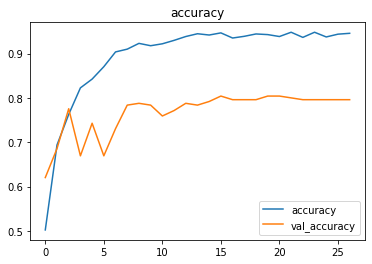

In [24]:
plt.plot(history['accuracy'])
plt.plot(history['val_accuracy'])
plt.legend(['accuracy', 'val_accuracy'])
plt.title('accuracy')

Text(0.5, 1.0, 'loss')

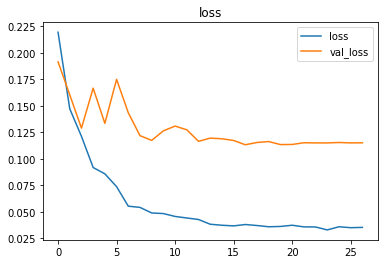

In [25]:
plt.plot(history['loss'])
plt.plot(history['val_loss'])
plt.legend(['loss', 'val_loss'])
plt.title('loss')

# Evaluate

In [26]:
model.evaluate(gen_test)

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

1/4 [======>.......................] - ETA: 21s - loss: 0.1083 - accuracy: 0.8281

  0%|          | 0/64 [00:00<?, ?it/s]

2/4 [==============>...............] - ETA: 8s - loss: 0.1346 - accuracy: 0.7734 

  0%|          | 0/52 [00:00<?, ?it/s]

4/4 [==============================] - 27s 7s/step - loss: 0.1179 - accuracy: 0.8115


[0.11791747808456421, 0.811475396156311]

In [27]:
from sklearn.metrics import classification_report, confusion_matrix

prediction = model.predict(gen_test)
y_pred = np.argmax(prediction, axis=-1) # [0, 1, 2, ...]

y_true = []
for img_test, y_test in gen_test:
  y_true.extend(y_test.argmax(axis = -1))
y_true = np.array(y_true)

print(y_true.shape, y_pred.shape)

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

1/4 [======>.......................] - ETA: 31s

  0%|          | 0/64 [00:00<?, ?it/s]

2/4 [==============>...............] - ETA: 7s 

  0%|          | 0/52 [00:00<?, ?it/s]

4/4 [==============================] - 31s 7s/step


  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

(244,) (244,)


In [28]:
# classification_report
print(classification_report(y_true, y_pred))

              precision    recall  f1-score   support

           0       0.88      0.81      0.84        96
           1       0.52      0.71      0.60        21
           2       0.33      0.60      0.43        10
           3       0.55      0.43      0.48        14
           4       0.96      0.90      0.93       103

    accuracy                           0.81       244
   macro avg       0.65      0.69      0.66       244
weighted avg       0.84      0.81      0.82       244



In [29]:
import pandas as pd
# Confusion matrix:
#   row: Ground truth
#   column: predict
mat = confusion_matrix(y_true, y_pred)
pd.DataFrame(mat,
      columns=["{}(predict)".format(all_class[i]) for i in range(5)],
      index=["{}(true)".format(all_class[i]) for i in range(5)])

,MD_Normal(predict),MD_old_water(predict),MD_sunburnt(predict),MD_bac_fungi(predict),Others(predict)
MD_Normal(true),78,7,4,3,4
MD_old_water(true),2,15,4,0,0
MD_sunburnt(true),1,2,6,1,0
MD_bac_fungi(true),0,4,4,6,0
Others(true),8,1,0,1,93


In [30]:
idx = np.nonzero(y_pred != y_true)[0]

false_pre = y_pred[idx]
false_true = y_true[idx]

false_img_list = []
for i in idx:
  false_img = gen_test[i//BATCH_SIZE][0][i%BATCH_SIZE]
  false_img_show = np.array(false_img, dtype = np.uint8)
  false_img_list.append(false_img_show)

print(false_img_list)

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

[array([[[155, 185, 128],
        [162, 191, 126],
        [185, 211, 139],
        ...,
        [ 78, 105,  54],
        [ 65,  92,  41],
        [ 64,  91,  40]],

       [[144, 173, 112],
        [140, 169, 105],
        [188, 216, 131],
        ...,
        [ 53,  78,  23],
        [103, 128,  73],
        [101, 129,  71]],

       [[147, 169, 113],
        [167, 196, 129],
        [162, 191, 101],
        ...,
        [ 97, 127,  65],
        [ 96, 126,  64],
        [ 89, 118,  53]],

       ...,

       [[145, 122, 128],
        [137, 115, 117],
        [128, 106, 108],
        ...,
        [ 23,  46,   4],
        [ 18,  27,   0],
        [ 27,  44,   9]],

       [[152, 138, 140],
        [146, 124, 126],
        [130, 108, 110],
        ...,
        [ 24,  44,   7],
        [ 21,  42,  11],
        [ 26,  42,  16]],

       [[127, 155, 112],
        [127, 155, 115],
        [130, 157, 117],
        ...,
        [ 24,  41,   4],
        [ 31,  46,  17],
        [ 25,  39,  13]

(46, 46)

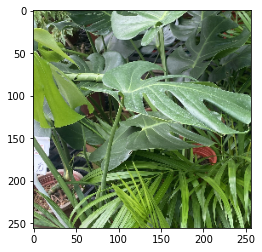

In [31]:
false_img_list[0]
plt.imshow(false_img_list[0])
len(false_img_list), len(idx)

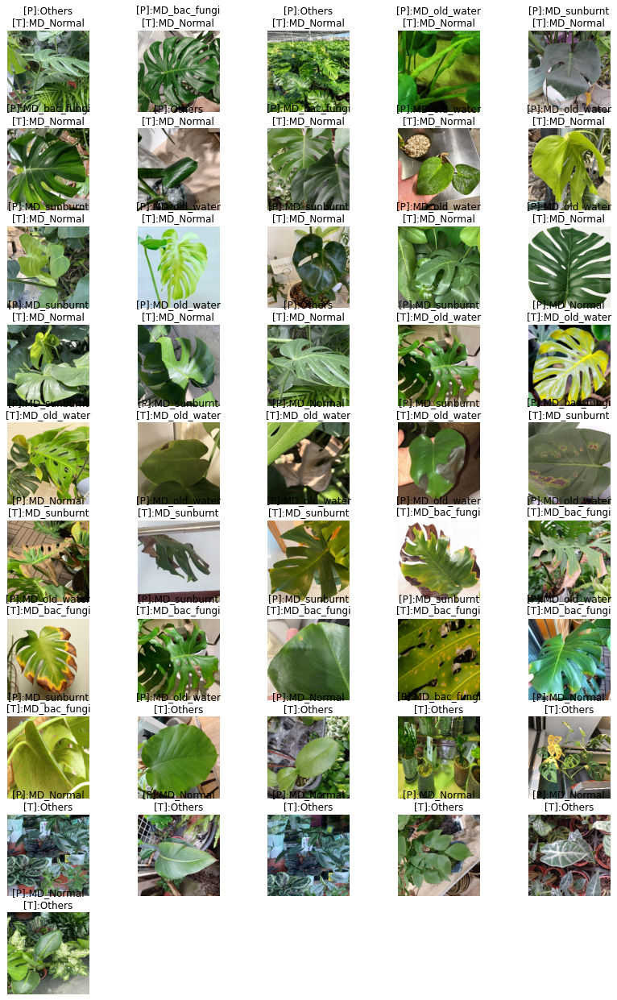

In [32]:
plt.figure(figsize=(14, 22))
width = 5
height = len(idx) // width + 1

for i in range(len(idx)):
    plt.subplot(height, width, i+1)
    title = "[P]:{}\n[T]:{}".format(all_class[false_pre[i]], all_class[false_true[i]])
    plt.title(title)
    plt.axis("off")
    plt.imshow(false_img_list[i])

# Load model

In [33]:
# 1. load whole model and weights
# model = models.load_model('/content/drive/MyDrive/generator_v2.h5')
# 2. Rebuild model before load weights !
# model2 = MyModel()
# model2.load_weights('CLF_model_weights.h5')

# Predict image

輸入一個網址https://foliageandme.com/wp-content/uploads/Pothos-Icon.jpg


/usr/local/lib/python3.7/dist-packages/urllib3/connectionpool.py:847: InsecureRequestWarning: Unverified HTTPS request is being made. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning)


1/1 [==============================] - 0s 41ms/step
MD_Normal 的機率: 0.28118944
MD_old_water 的機率: 0.06473052
MD_sunburnt 的機率: 0.015658308
MD_bac_fungi 的機率: 0.08416196
Others 的機率: 0.5542597
答案是: Others


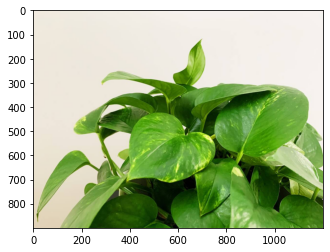

In [35]:
import requests

url = input("輸入一個網址")
h = {
    "user-agent":"Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/105.0.0.0 Safari/537.36"
}

response = requests.get(url, stream=True, verify=False, headers=h)
img = Image.open(response.raw)
img_r = img.convert("RGB").resize((256, 256))
img_r = np.array(img_r).reshape(1, 256, 256, 3)
img_r = tf.keras.applications.efficientnet_v2.preprocess_input(img_r, data_format=None)
proba = model.predict(img_r)[0]
for t, p in zip(all_class, proba):
    print(t, "的機率:", p)
ans = all_class[proba.argmax(axis=-1)]
print("答案是:", ans)
plt.imshow(img)